<br>

<h1 style="text-align: center;">Skin Cancer Classification</h1>


<br>

## Initial Setup

---


In [1]:
# Import the libraries
import os
import cv2
import math
import shutil
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from kaggle.api.kaggle_api_extended import KaggleApi
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import precision_score, confusion_matrix
import tensorflow as tf
from tensorflow import keras
from keras.models import load_model
from sklearn.metrics import confusion_matrix, accuracy_score
import plotly.graph_objects as go
from sklearn import linear_model
import xplique
from xplique.attributions import Lime, KernelShap
from xplique.plots import plot_attributions
import scipy.stats as stats

In [2]:
# Set the matplotlib style
plt.style.use('ggplot')

In [3]:
# Turn off warnings
warnings.filterwarnings('ignore')

In [4]:
# Show all columns in the dataframe
pd.set_option('display.max_columns', None)

<br>

<h1 style="text-align:center;">Section 1 - Business Understanding </h1>



<br>

## Task 1.1: Market Research

---

#### What image classifier product or product feature could make organizational life easier?

- Develop a simple-to-use AI tool that can identify and classify different types of skin lesions (e.g., Melanocytic nevi, Melanoma, Benign keratosis), with high accuracy.
- Design the system to be easily integrated with existing healthcare technology, enhancing its accessibility for medical professionals.

#### What problem can I alleviate for an organization?

- Tackle the issue of mis-diagnosis in dermatology caused by the similar appearance of various skin lesions.
- Provide a reliable, data-driven second opinion to support dermatologists' decisions, thereby increasing diagnostic accuracy.
- Enhance overall confidence in treatment plans by ensuring correct identification of lesion types.

#### How can I improve work within an organization?

- Significantly reduce the time it takes for a diagnosis by using fast, AI-driven image analysis.
- Improve the precision of skin lesion classification, leading to more effective and appropriate treatments.
- Decrease the pressure on dermatologists, allowing them to focus more on patient care and less on time-intensive diagnosis processes.

<br>

## Task 1.2: Stakeholder Analysis

---

### 1. Stakeholders Characteristics

__Stakeholders__ include all individuals or groups directly or indirectly affected by or influencing decisions. 

Below is a detailed overview of each stakeholder, highlighting key aspects such as their power, influence, interest, expectations, needs, and preferences.

<br>

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Stakeholder</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Power</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Influence</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Interest</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Expectations</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Needs</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Preferences</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Dermatologists</td>
            <td style="border:1px solid black; padding:10px;">Medical expertise, direct user</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">Reliable, accurate results</td>
            <td style="border:1px solid black; padding:10px;">Effective diagnosis tools</td>
            <td style="border:1px solid black; padding:10px;">Quick, accurate diagnosis</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Patients</td>
            <td style="border:1px solid black; padding:10px;">Directly affected by diagnosis</td>
            <td style="border:1px solid black; padding:10px;">Moderate</td>
            <td style="border:1px solid black; padding:10px;">Low</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">Accurate, timely detection</td>
            <td style="border:1px solid black; padding:10px;">Non-invasive assessments</td>
            <td style="border:1px solid black; padding:10px;">Quick, painless procedures</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Healthcare Administrators</td>
            <td style="border:1px solid black; padding:10px;">Oversee clinic operations</td>
            <td style="border:1px solid black; padding:10px;">Moderate</td>
            <td style="border:1px solid black; padding:10px;">Moderate</td>
            <td style="border:1px solid black; padding:10px;">Moderate</td>
            <td style="border:1px solid black; padding:10px;">Efficiency, integration</td>
            <td style="border:1px solid black; padding:10px;">Cost-effective tools</td>
            <td style="border:1px solid black; padding:10px;">Ease of use, reliability</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Medical Researchers</td>
            <td style="border:1px solid black; padding:10px;">Refine classification model</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">High</td>
            <td style="border:1px solid black; padding:10px;">Advanced features, accuracy</td>
            <td style="border:1px solid black; padding:10px;">Reliable data</td>
            <td style="border:1px solid black; padding:10px;">Cutting-edge technology</td>
        </tr>
    </tbody>
</table>



<br>

### 2. Prioritizing Stakeholders


Below is our use of the __Power and Interest grid matrix__ to sort stakeholders by their influence and interest. This helps us decide how much attention to give each group for successful project management.


<br>


<table style="width:50%; border-collapse: collapse; border: 1px solid black; margin-left: 30px;">
  <tr>
    <td style="border: 1px solid black; height: 150px; text-align: center; vertical-align: middle;">Patients<br/>Low Power / High Interest</td>
    <td style="border: 1px solid black; height: 150px; text-align: center; vertical-align: middle;">Dermatologists<br/>High Power / High Interest</td>
  </tr>
  <tr>
    <td style="border: 1px solid black; height: 150px; text-align: center; vertical-align: middle;">Crowds<br/>(e.g., General Public)<br/>Low Power / Low Interest</td>
    <td style="border: 1px solid black; height: 150px; text-align: center; vertical-align: middle;">Healthcare Administrators<br/>High Power / Moderate Interest</td>
  </tr>
</table>

<div style="display: flex; justify-content: space-between; align-items: center;">
  <div style="writing-mode: tb-rl; transform: rotate(180deg); margin-left: -10px; margin-top: -350px;">👇 Stakeholder Interest 👇</div>
  <div style="text-align: center; margin-left:-670px; margin-top: 10px;">👉 Stakeholder Power 👉</div>
  <div style="margin-right: -20px;"> </div>
</div>

### 3. Main Stakeholder

- We chose __dermatologists__ as our main stakeholders based on their decision-making impact in clinical settings.
- They have the authority to recommend or decide on diagnostic tools, hence their high power.
- Their interest is equally high because the tool could directly affect their daily work and patient care.
- The decision to focus on dermatologists was made to ensure the tool’s relevance and adoption in clinical practice.

<br>

## Task 1.3: The DAPS Diagram

---

The __Data-Analytic Problem Structure (DAPS)__ serves as a guide through the Business Understanding phase of CRISP-DM, providing a structured approach for defining and scoping data science projects. It's a semi-formal specification technique designed to help data scientists and analysts clarify the objectives and expected outcomes of their projects. Here's a more organized overview, including complementary information where applicable:

__1. The data-analytic problem:__ <br>
- The model predicts if a skin image is of Melanocytic nevi, Melanoma, or Benign keratosis.
- It's implied that the model uses correlational data to make predictions and might explore causality in dermatoscopic features.

__2. The decision framework:__ <br> 
- Dermatologists are the decision-makers (agents) using the tool.
- The model is used during initial patient examinations and follow-up visits (timing).
- Decisions informed by the model include the need for biopsy, surgical removal, or other monitoring strategies (interventions).

__3. The business value:__ <br>
- Enhances organizational KPIs by facilitating fast and accurate diagnoses.
- Aims to surpass human-level accuracy, increasing diagnostic confidence.
- The ultimate value lies in enhancing patient care through more precise and timely diagnoses, likely contributing to higher treatment success rates and patient satisfaction.

<br>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/DAPs_diagram.png" width=70%>
</div>

<br>

<br>

## Task 1.4: The First Idea

---

##### Application Name

- Canceric

##### Application Concept

- Develop an AI-powered diagnostic application that dermatologists can use to classify skin lesions accurately.

##### Core Functionality

- Integrates advanced image recognition and machine learning algorithms to distinguish between Melanocytic nevi, Melanoma, and Benign keratosis.
- Analyzes dermatoscopic features to assist in potential causal understanding of lesion types.

##### User Interaction and Experience

- Optimized for dermatologists’ use during patient examinations and follow-up visits.
- Streamlines the decision-making process by providing actionable insights, such as the necessity for biopsies or the urgency of intervention.

##### Decision-Making Framework

- The application will be used at critical decision points in the patient care process.
- It aims to inform a range of clinical actions, including biopsies, surgeries, and treatment monitoring.

##### Business Value and Organizational Impact

- Offers fast, reliable diagnostics, significantly reducing the time from patient examination to treatment decision.
- Aims to achieve and surpass human-level diagnostic accuracy, contributing to improved patient trust and healthcare outcomes.
- Addresses organizational key performance indicators (KPIs) by speeding up the diagnosis process and providing more accurate diagnoses, thereby potentially reducing the rate of misdiagnosis and improving overall treatment success.
- Expected to enhance patient satisfaction by providing a non-invasive, quick diagnostic process and contributing to more personalized treatment plans.

<br>

<h1 style="text-align:center;"> Section 2A - Responsible AI </h1>


<br>

## Task 2.1: Create a Dataset 

---

### Download the Dataset

In this section, we will create a dataset for skin cancer classification. Our primary source for the data is the 'skin-cancer-mnist-ham10000' dataset on Kaggle, which was compiled by user 'kmader'. This dataset is a rich collection of dermatoscopic images of common skin lesions, making it an ideal resource for our project.

In [3]:
# Function for downloading the dataset
def download_dataset(download_flag):

    # If flag is True
    if download_flag:

        # Initialize the Kaggle API
        api = KaggleApi()
        api.authenticate()

        # Create a directory dataset
        os.makedirs("./data/raw/images", exist_ok=True)
        os.makedirs("./data/processed", exist_ok=True)

        # Download the dataset
        api.dataset_download_files('kmader/skin-cancer-mnist-ham10000', path="./data/raw", unzip=True)

        # Move all images from HAM10000_images_part_1 and HAM10000_images_part_2 to the images folder
        for i_folder_name in ["HAM10000_images_part_1", "HAM10000_images_part_2"]:
            for filename in os.listdir(f"./data/raw/{i_folder_name}"):
                shutil.move(f"./data/raw/{i_folder_name}/{filename}", f"./data/raw/images/{filename}")

        # Delete the empty folders
        os.rmdir("./data/raw/HAM10000_images_part_1")
        os.rmdir("./data/raw/HAM10000_images_part_2")

    # Report
    print("The dataset has been downloaded.")

In [4]:
# Download the dataset
download_dataset(download_flag=False)

The dataset has been downloaded.


<br>

### Organize the Dataset

After downloading the dataset, we undertook the task of rearranging and formatting it to suit our specific needs. This involved categorizing the images based on the type of skin lesion they represent. This step is crucial as it allows our machine learning model to effectively learn and distinguish between different types of skin cancer.

In [20]:
# Function for organizing the dataset folder
def organize_dataset():

    # Dictionary for the lesion types
    lesion_type_d = {
        'nv': 'Melanocytic nevi',
        'mel': 'Melanoma',
        'bkl': 'Benign keratosis',
        # 'bcc': 'Basal cell carcinoma',
        # 'akiec': 'Actinic keratoses',
        # 'vasc': 'Vascular lesions',
        # 'df': 'Dermatofibroma'
    }

    # Load the metadata
    metadata = pd.read_csv("./data/raw/HAM10000_metadata.csv")

    # Add info to metadata
    metadata.dx=metadata.dx.astype('category', copy=True)
    metadata['label']=metadata.dx.cat.codes 
    metadata["label"] = metadata["label"] - min(metadata["label"])
    metadata['lesion_type']= metadata.dx.map(lesion_type_d)

    # Only keep instances with given classes
    metadata = metadata[metadata['lesion_type'].isin(["Melanocytic nevi", "Melanoma", "Benign keratosis"])]

    # Balance dataset; Only keep 1099 images of each lesion type
    metadata = metadata.groupby('lesion_type').apply(lambda x: x.sample(1099)).reset_index(drop = True)    

    # Split to training set with 70% of the images, the validation set contains 20% of the images, and the test set contains 10% of the images
    train_df, test_df = train_test_split(metadata, test_size=0.3, stratify=metadata['lesion_type'])
    validation_df, test_df = train_test_split(test_df, test_size=0.33, stratify=test_df['lesion_type'])

    # Loop over each split
    for i_folder_name in ["train", "test", "validation"]:

        # For each lesion type (within each split folder) create an empty folder
        for i_lesion_type in lesion_type_d.values():
            os.makedirs(f"./data/processed/{i_folder_name}/{i_lesion_type}", exist_ok=True)

        # Get the metadata for the current split
        metadata_temp = eval(f"{i_folder_name}_df")

        # Copy/paste the images to the correct folder
        for index, row in metadata_temp.iterrows():
            shutil.copy(f"./data/raw/images/{row['image_id']}.jpg", f"./data/processed/{i_folder_name}/{row['lesion_type']}/{row['image_id']}.jpg")
            metadata.at[index, 'image path'] = f"./data/processed/{i_folder_name}/{row['lesion_type']}/{row['image_id']}.jpg"
            metadata.at[index, 'split'] = i_folder_name

    # Save the metadata
    metadata.to_csv("./data/processed/metadata.csv", index=False)

    # Report
    print("The dataset has been organized!")

In [21]:
# Organize the dataset
organize_dataset()

C:\Users\sohei\AppData\Local\Temp\ipykernel_856\446292640.py:28: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  metadata = metadata.groupby('lesion_type').apply(lambda x: x.sample(1099)).reset_index(drop = True)


The dataset has been organized!


In [8]:
# Load the metadata
metadata = pd.read_csv("./data/processed/metadata.csv")

metadata

,lesion_id,image_id,dx,dx_type,age,sex,localization,label,lesion_type,image path,split
0,HAM_0000364,ISIC_0024505,bkl,histo,40.0,female,face,2,Benign keratosis,./data/processed/train/Benign keratosis/ISIC_0...,train
1,HAM_0007621,ISIC_0031321,bkl,histo,70.0,male,back,2,Benign keratosis,./data/processed/train/Benign keratosis/ISIC_0...,train
2,HAM_0001487,ISIC_0031601,bkl,consensus,60.0,male,neck,2,Benign keratosis,./data/processed/train/Benign keratosis/ISIC_0...,train
3,HAM_0004555,ISIC_0033200,bkl,histo,75.0,male,lower extremity,2,Benign keratosis,./data/processed/validation/Benign keratosis/I...,validation
4,HAM_0004556,ISIC_0028123,bkl,consensus,65.0,female,face,2,Benign keratosis,./data/processed/validation/Benign keratosis/I...,validation
...,...,...,...,...,...,...,...,...,...,...,...
3292,HAM_0004579,ISIC_0025603,mel,histo,75.0,male,trunk,4,Melanoma,./data/processed/train/Melanoma/ISIC_0025603.jpg,train
3293,HAM_0001863,ISIC_0033125,mel,histo,70.0,male,upper extremity,4,Melanoma,./data/processed/train/Melanoma/ISIC_0033125.jpg,train
3294,HAM_0003330,ISIC_0028696,mel,histo,75.0,male,abdomen,4,Melanoma,./data/processed/validation/Melanoma/ISIC_0028...,validation
3295,HAM_0005274,ISIC_0033141,mel,histo,55.0,male,upper extremity,4,Melanoma,./data/processed/train/Melanoma/ISIC_0033141.jpg,train


In [4]:
# Distribution of the lesion types across the splits 
pd.DataFrame(metadata.groupby(['split', 'lesion_type']).size(), columns=['count'])

count
split      lesion_type            
test       Benign keratosis    109
           Melanocytic nevi    109
           Melanoma            109
train      Benign keratosis    769
           Melanocytic nevi    769
           Melanoma            769
validation Benign keratosis    221
           Melanocytic nevi    221
           Melanoma            221

As you can see, the number of images per class (across different splits) are equivalent together.

<br>

## Task 2.2: Identify, and Describe Bias

---

### Introduction to Bias in Skin Cancer Classification

Bias refers to an imbalance or unfair preference in the data. It can happen when certain information is overrepresented or underrepresented. This leads to models that might not work equally well for everyone or might favor one group over another. Basically, bias can cause a model to be less accurate or fair in its predictions.

In the skin cancer recognition dataset, potential biases can include:

- Representation Bias: Too many or too few images from certain age groups, genders, or skin types.
- Diagnostic Bias: Some types of skin cancer are more common than others in the data.
- Localization Bias: More images of skin cancer on certain body parts than others.
- Label Bias: Mistakes or guesses in the skin cancer labels.

<br>

### Identifying Bias

Below you can see the list and description of identified biases.

- __Skin tone__: The dataset predominantly contains images of individuals with light skin color. This information was not provided in the metadata. However, upon examining the images, this fact becomes apparent.

In [20]:
def visualize_img_samples(sample_size):

    # Randomely sample N instances
    metadata_ = metadata.sample(sample_size).reset_index(drop=True)

    # Create a new figure
    plt.figure(figsize=(23, 1.2 * len(metadata_)))

    # Loop over the instances
    for i_index, i_row in metadata_.iterrows():

        # Load the image
        img = Image.open(i_row["image path"])

        # Resize the image to a smaller size
        img = img.resize((128, 128))

        # Convert the image to an array
        img = np.array(img)

        # Normalize the image
        img = img / 255.0

        # Create a subplot for this image
        plt.subplot(len(metadata_), 20, i_index + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.show()

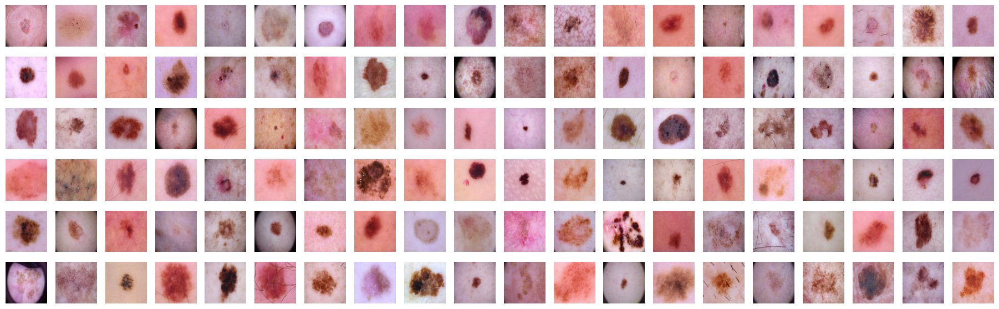

In [24]:
visualize_img_samples(sample_size=120)

- __Age__: The dataset predominantly contains images from individuals with older age years. This means that very young people are not included too much.

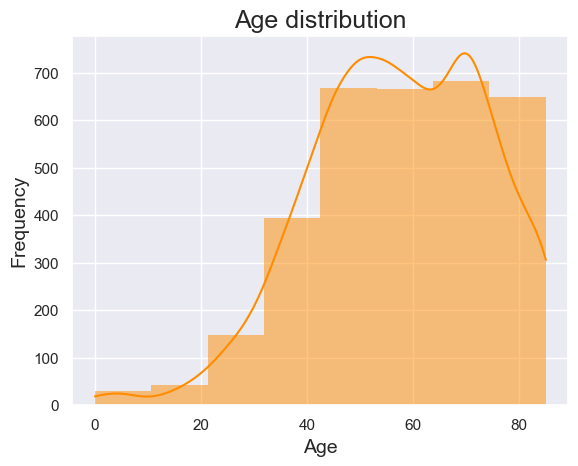

In [15]:
# Age distribution

# Set the style of seaborn
sns.set(style="darkgrid")

# Create the histogram
sns.histplot(data=metadata, x="age", bins=8, kde=True, color="darkorange", linewidth=0)

# Set the labels and title
plt.xlabel("Age", size=14)
plt.ylabel("Frequency", size=14)
plt.title("Age distribution", size=18)

# Show the plot
plt.show()

- __Localization type__: There is an imbalance number of images among different localizations (i.e. different parts of the body).

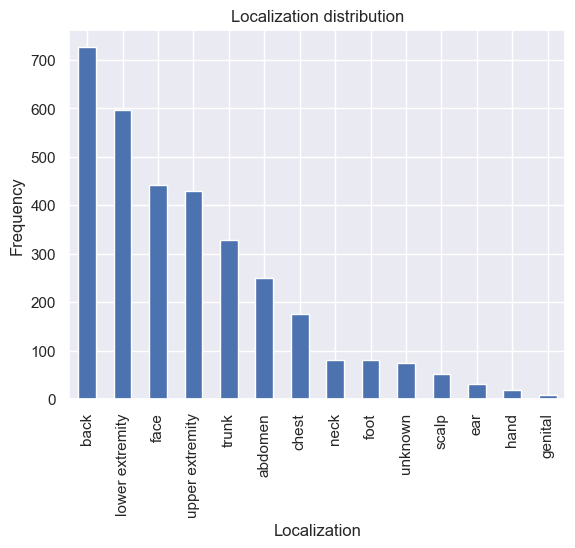

In [16]:
# Distribution of localization
metadata["localization"].value_counts().plot(kind='bar', title="Localization distribution", xlabel="Localization", ylabel="Frequency")
plt.show()

In short, here are the types of bias that were identified:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Type of Bias</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Selection Bias</td>
            <td style="border:1px solid black; padding:10px;">The dataset predominantly contains images from individuals with light skin color, indicating a preference in data collection that may not be representative of the wider population.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Sampling Bias</td>
            <td style="border:1px solid black; padding:10px;">The age distribution skews towards older individuals, suggesting that younger age groups are underrepresented in the sample.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Coverage Bias</td>
            <td style="border:1px solid black; padding:10px;">There is an uneven number of images for different lesion localizations, meaning not all body areas are equally represented, which can affect the model's diagnostic capability across different body regions.</td>
        </tr>
    </tbody>
</table>

<br>

### Possible Harms and Ramifications

In the following table, you can read the possible ramifications (e.g., harm) of the identified bias instance.


<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Bias Type</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Harm/Ramification</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Who's Affected</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">When It's Problematic</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">How To Mitigate</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Skin Tone</td>
            <td style="border:1px solid black; padding:10px;">Poor performance diagnosing darker skin tones.</td>
            <td style="border:1px solid black; padding:10px;">Individuals with darker skin.</td>
            <td style="border:1px solid black; padding:10px;">Screening and diagnostic procedures.</td>
            <td style="border:1px solid black; padding:10px;">Ensure diverse skin tone representation in the dataset.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Age</td>
            <td style="border:1px solid black; padding:10px;">Underestimating risk in younger people.</td>
            <td style="border:1px solid black; padding:10px;">Younger individuals.</td>
            <td style="border:1px solid black; padding:10px;">Diagnoses in younger demographics.</td>
            <td style="border:1px solid black; padding:10px;">Balance age distribution in the dataset.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Localization</td>
            <td style="border:1px solid black; padding:10px;">Less accuracy diagnosing less represented areas.</td>
            <td style="border:1px solid black; padding:10px;">Individuals with lesions in less common areas.</td>
            <td style="border:1px solid black; padding:10px;">Screening for lesions in varied body areas.</td>
            <td style="border:1px solid black; padding:10px;">Include more images from underrepresented localizations.</td>
        </tr>
    </tbody>
</table>

<br>

## Task 2.3: Propose Individual Fairness Method

---


#### 2.3.1. Identifying a Sensitive/Protected Attribute

__Sensitive/protected attributes__ are characteristics of individuals that are legally or ethically considered for special protection against discrimination. These attributes are often recognized in legislation and by societal norms as being susceptible to bias and unfair treatment. 

In the current dataset, these are the sensitive/protected attributes.

- age: Since the prevalence of certain skin conditions may vary with age.
- sex: Different genders might present different skin characteristics.

In [25]:
# Protected attributes in metadata
metadata[["age", "sex"]]

,age,sex
0,40.0,female
1,70.0,male
2,60.0,male
3,75.0,male
4,65.0,female
...,...,...
3292,75.0,male
3293,70.0,male
3294,75.0,male
3295,55.0,male


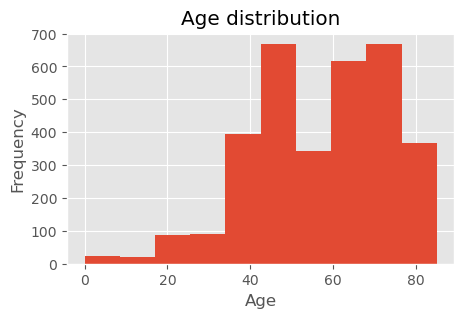

In [17]:
# Attribute #1 - Age distribution 
plt.figure(figsize=(5, 3))
metadata["age"].plot(kind='hist', title="Age distribution", xlabel="Age", ylabel="Frequency")
plt.show()

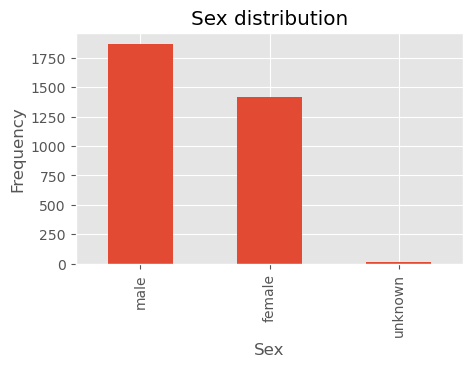

In [19]:
# Attribute #2 - Sex distribution
plt.figure(figsize=(5, 3))
metadata["sex"].value_counts().plot(kind='bar', title="Sex distribution", xlabel="Sex", ylabel="Frequency")
plt.xlabel("Sex")
plt.ylabel("Frequency")
plt.show()


<br>

#### 2.3.2. Proposing an Individual Fairness Method

For this dataset, there can be two options regarding the individual fairness (i.e., "Fairness Through Awareness" and "Fairness Through Unawareness"):

- Fairness Through Unawareness: Removing the sensitive attributes (e.g., age, sex) to prevent potential biases related to these factors.
- Fairness Through Awareness: Adding dataset to the under-represented group within each sensitive attributes.

<br>

For the rest of this dataset we will go with the "<b><u>Fairness Through Unawareness</u></b>" regarding the age and sex. 

There are few reasons on why this is a better approach for our case:

<table style="width:70%; border:1px solid black; text-align: center; margin-left: auto; margin-right: auto; ">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:center;">Aspect</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Focuses on Skin Health</strong></td>
            <td style="border:1px solid black; padding:10px;">Ignores irrelevant details like race or age, and just looks at the skin condition.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Less Bias</strong></td>
            <td style="border:1px solid black; padding:10px;">Avoids societal or cultural prejudices by not considering personal attributes.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Fair for Everyone</strong></td>
            <td style="border:1px solid black; padding:10px;">Treats all patients the same, making decisions based only on skin analysis.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Reduces Past Bias Effects</strong></td>
            <td style="border:1px solid black; padding:10px;">Doesn’t let historical biases in old data affect current decisions.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Ethically Sound</strong></td>
            <td style="border:1px solid black; padding:10px;">Meets medical standards by ensuring equal treatment for all patients.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;"><strong>Works for All</strong></td>
            <td style="border:1px solid black; padding:10px;">Useful across different groups since it only examines the disease, not who the patient is.</td>
        </tr>
    </tbody>
</table>




<br>

## Task 2.4: Create Infographic; Group Fairness Metrics

---

__1. Strengths__
- The infographic is clear, visually pleasing, and presents the information in an easy-to-follow structure.
- [Noah Ivanisevic, 235738] The use of icons and color coding aids understanding.

__2. Areas for Improvement__
- Include examples or case studies for real world impact.
- [Noah Ivanisevic, 235738] The metrics are better to get updated to match the fairness compass.

__3. Next Steps for Improvement__
- Update the metrics.
- Add simple real-life examples to make the concepts more relatable.
- Define technical terms in simpler language.
- Include a way to collect feedback for future improvements.

__4. Reflection__
- Thanks for the feedback of my peer, I've included the correct metrics and also made the explaination more simpler and less technical.
- I've included few examples of case studies in real world impact part.


__5. Infographic__
- <a href="https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-SoheilMohammadpour231754/blob/main/Deliverables/skin%20cancer%20classification/assets/group%20fairness%20infographic.pdf">group fairness infographic.pdf</a>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/group fairness infographic.jpg" width=65%>
</div>

<br>

## Task 2.5: Group Fairness Taxonomy Function


---

Fairness compass is used to select appropriate group fairness metric for a classification task

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/Fairness Compass.jpg" width=1000>
</div>

##### Step 1 - Select Dataset

Select a dataset of your choice (e.g. Imsitu, MS COCO, COMPAS, etc.).

__ANSWER:__

*In this section, we will be using the dataset for skin cancer classification similar to the rest of the creative brief. However, it is now converted into a binary problem (melanoma vs. not melanoma).*

In [5]:
# Load the metadata
df = pd.read_csv("./data/processed/metadata.csv")

# Change any lesion type that is not melanoma to not melanoma
df['lesion_type'] = df['lesion_type'].apply(lambda x: 'Melanoma' if x == 'Melanoma' else 'Not Melanoma')

# Update the label integers
df['label'] = df['lesion_type'].apply(lambda x: 1 if x == 'Melanoma' else 0)

# Sample from each class equally
df = df.groupby('lesion_type').apply(lambda x: x.sample(len(df[df['lesion_type'] == 'Melanoma'])))

# Reset index
df = df.reset_index(drop=True)

df

,lesion_id,image_id,dx,dx_type,age,sex,localization,label,lesion_type,image path,split
0,HAM_0001284,ISIC_0024972,mel,histo,75.0,female,ear,1,Melanoma,./data/processed/test/Melanoma/ISIC_0024972.jpg,test
1,HAM_0006899,ISIC_0025550,mel,histo,80.0,female,lower extremity,1,Melanoma,./data/processed/test/Melanoma/ISIC_0025550.jpg,test
2,HAM_0002391,ISIC_0027604,mel,histo,70.0,male,upper extremity,1,Melanoma,./data/processed/validation/Melanoma/ISIC_0027...,validation
3,HAM_0007016,ISIC_0027838,mel,histo,35.0,female,abdomen,1,Melanoma,./data/processed/train/Melanoma/ISIC_0027838.jpg,train
4,HAM_0005280,ISIC_0033063,mel,histo,70.0,male,upper extremity,1,Melanoma,./data/processed/train/Melanoma/ISIC_0033063.jpg,train
...,...,...,...,...,...,...,...,...,...,...,...
2193,HAM_0007276,ISIC_0028538,nv,histo,25.0,female,unknown,0,Not Melanoma,./data/processed/train/Melanocytic nevi/ISIC_0...,train
2194,HAM_0006281,ISIC_0033791,bkl,histo,75.0,male,lower extremity,0,Not Melanoma,./data/processed/train/Benign keratosis/ISIC_0...,train
2195,HAM_0003542,ISIC_0033714,nv,histo,35.0,male,back,0,Not Melanoma,./data/processed/train/Melanocytic nevi/ISIC_0...,train
2196,HAM_0007219,ISIC_0029227,bkl,consensus,70.0,male,hand,0,Not Melanoma,./data/processed/train/Benign keratosis/ISIC_0...,train


<br>

##### Step 2 - Split Dataset

Create a train/validation/test split for your dataset.

__ANSWER:__


In [6]:
# Update the split column (since we changed the label column into binary values)

# Split to training set with 70% of the images, the validation set contains 20% of the images, and the test set contains 10% of the images
train_df, test_df = train_test_split(df, test_size=0.3, stratify=df['lesion_type'])
validation_df, test_df = train_test_split(test_df, test_size=0.33, stratify=test_df['lesion_type'])

# Loop over each split and update the split column
for i_folder_name in ["train", "test", "validation"]:
    metadata_temp = eval(f"{i_folder_name}_df")
    df.loc[df['image_id'].isin(metadata_temp['image_id']), 'split'] = i_folder_name

In [7]:
# Distribution of the lesion types across the splits 
pd.DataFrame(df.groupby(['split', 'lesion_type']).size(), columns=['count'])

count
split      lesion_type        
test       Melanoma        109
           Not Melanoma    109
train      Melanoma        769
           Not Melanoma    769
validation Melanoma        221
           Not Melanoma    221

In [8]:
# Training set split in metadata
train_df = df[df['split'] == "train"]

# Create a data generator
train_datagen = ImageDataGenerator(
    rescale=1./255.,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=360,
)

# Load images from dataframe
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    directory=None,
    x_col="image path",
    y_col="lesion_type",
    subset="training",
    batch_size=32,
    seed=42,
    shuffle=True,
    class_mode="binary",
    target_size=(224,224)
)

Found 1538 validated image filenames belonging to 2 classes.


In [9]:
# Validation set split in metadata
val_df = df[df['split'] == "validation"]

# Create a data generator
val_datagen = ImageDataGenerator(
    rescale=1./255.,
)

# Load images from dataframe
val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_df,
    directory=None,
    x_col="image path",
    y_col="lesion_type",
    subset="training",
    batch_size=32,
    seed=42,
    shuffle=True,
    class_mode="binary",
    target_size=(224,224)
)

Found 442 validated image filenames belonging to 2 classes.


In [10]:
# Test set split in metadata
test_df = df[df['split'] == "test"]

# Create a data generator
test_datagen = ImageDataGenerator(
    rescale=1./255.,
)

# Load images from dataframe
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    directory=None,
    x_col="image path",
    y_col="lesion_type",
    subset="training",
    batch_size=32,
    seed=42,
    shuffle=True,
    class_mode="binary",
    target_size=(224,224)
)

Found 218 validated image filenames belonging to 2 classes.


<br>

##### Step 3 - Define the Task

Define a binary classification task using the dataset selected in the previous step.

__ANSWER:__

*The task is to classify the images into two classes: Melanoma and Benign keratosis*

<br>

##### Step 4 - Identify Protected/Sensitive Attributes

Select a protected/sensitive attribute in the dataset (Note: it is simpler to have two categories, e.g., ‘male' and ‘female'.).

__ANSWER:__

*There are two protected attributes; However, we will use only "sex" for rest of the code*

In [11]:
# Protected attributes
df[["age", "sex"]]

,age,sex
0,75.0,female
1,80.0,female
2,70.0,male
3,35.0,female
4,70.0,male
...,...,...
2193,25.0,female
2194,75.0,male
2195,35.0,male
2196,70.0,male


<br>

##### Step 5 - Split Test Set Based on Protected Attribute

Split your test set based on the protected/sensitive attribute.

__ANSWER:__


In [12]:
# Split the test set based on gender
test_male_df = test_df[test_df["sex"] == "male"]
test_female_df = test_df[test_df["sex"] == "female"]

# Report
print(f"Number of rows in male test set: {test_male_df.shape[0]}")
print(f"Number of rows in female test set: {test_female_df.shape[0]}")

Number of rows in male test set: 121
Number of rows in female test set: 97


In [13]:
# Create data generator
test_male_datagen = ImageDataGenerator(rescale=1./255.)
test_female_datagen = ImageDataGenerator(rescale=1./255.)

In [14]:
# Load images from dataframe
test_male_generator = test_male_datagen.flow_from_dataframe(dataframe=test_male_df, directory=None, x_col="image path", y_col="lesion_type", subset="training", batch_size=1, seed=42, shuffle=True, class_mode="binary", target_size=(224,224))
test_female_generator = test_female_datagen.flow_from_dataframe(dataframe=test_female_df, directory=None, x_col="image path", y_col="lesion_type", subset="training", batch_size=1, seed=42, shuffle=True, class_mode="binary", target_size=(224,224))

Found 121 validated image filenames belonging to 2 classes.
Found 97 validated image filenames belonging to 2 classes.


<br>

##### Step 6 - Specify Policy or Worldview/Equal Base Rate

Specify a policy or ‘worldview'/equal base rates? for your binary classification task.
- Policy: Are there any anti-discrimination policies in the deployment environment due to laws, regulations, or internal guidelines?
- Equal base rate: Base rates can vary across groups. If so, decide if your fairness definition should reflect this. If you attribute varying base rates to data collection or historical discrimination, you might choose equal rates to promote fairness.


__ANSWER:__


Policy:
- No.
- There is no specific law or regulation (for anti-discrimination) when it comes to skin cancer classification. 

Equal base rate:

- No.
- Skin cancer base rates vary between genders due to biological factors and social factors (i.e., some jobs require workers to face sun during a day, and these industries are usually dominated toward a specific gender). 
- Equal base rates for all genders may not be suitable in this context.
- The classifier should mirror actual medical base rates to benefit all patients effectively.

<br>

##### Step 7 - Determine Evaluation Metric

Determine which evaluation metric is most sensitive to fairness:

- If your intervention is punitive in nature (e.g., determining whom to deny bail), individuals may be harmed by intervening on them in error so you may care more about metrics that focus on False Positives (Precision: Limit the number of False Positives).

- If your intervention is assistive in nature (e.g., determining who should receive a food subsidy), individuals may be harmed by failing to intervene on them when they have needs, so you may care more about metrics that focus on False Negatives (Recall: Limit the number of False Negatives) (Source).

__ANSWER:__

- Option B (Recall).
- The nature of the task is assistive, aiming to correctly identify cases of skin cancer.
- A missed diagnosis (False Negative) is potentially more harmful than a mistaken diagnosis (False Positive).
- Therefore, __Recall (Sensitivity)__ is the key evaluation metric, as it focuses on limiting the number of False Negatives.
- High Recall ensures that the model does not miss true cases of skin cancer, which is essential for patient outcomes.

<br>

##### Step 8 - Determine Error

Determine which error is most sensitive to fairness regarding your binary classification task (i.e., False Positives, False Negatives or False Positives and False Negatives). Important: It depends on the label you assign to the target variables categories (e.g., positive and negative class)!

__ANSWER:__

- False Negative.
- A False Negative could mean a missed diagnosis of cancer, which is a significant risk to the patient's health.
- A False Positive may lead to additional tests, but it’s less harmful than a missed diagnosis.

<br>

##### Step 9 - Build a Model

Build an ANN model in Python, using Tensorflow's Keras, that can be used to classify data instances into two classes (i.e., binary classification task).

__ANSWER:__


In [15]:
# Model for binary classification of images
model_fairness = keras.Sequential([
    keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    keras.layers.MaxPooling2D((2, 2)),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D((2, 2)),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.Flatten(),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model_fairness.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 64)        36928     
                                                                 
 flatten (Flatten)           (None, 173056)            0

<br>

##### Step 10 - Train the Model

Train the binary classification model on the dataset. You can save the weights of the model to a .h5 file.

__ANSWER:__


In [17]:
# Compile the model
model_fairness.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model_fairness.fit(train_generator, epochs=10, validation_data=val_generator)

Epoch 1/10


49/49 [==============================] - 61s 1s/step - loss: 0.9078 - accuracy: 0.5293 - val_loss: 0.7091 - val_accuracy: 0.5000
Epoch 2/10
49/49 [==============================] - 45s 913ms/step - loss: 0.6823 - accuracy: 0.5683 - val_loss: 0.6749 - val_accuracy: 0.5543
Epoch 3/10
49/49 [==============================] - 46s 931ms/step - loss: 0.6729 - accuracy: 0.5897 - val_loss: 0.6661 - val_accuracy: 0.5769
Epoch 4/10
49/49 [==============================] - 44s 888ms/step - loss: 0.6845 - accuracy: 0.5572 - val_loss: 0.6718 - val_accuracy: 0.5950
Epoch 5/10
49/49 [==============================] - 44s 899ms/step - loss: 0.6843 - accuracy: 0.5884 - val_loss: 0.7711 - val_accuracy: 0.5113
Epoch 6/10
49/49 [==============================] - 46s 944ms/step - loss: 0.6657 - accuracy: 0.6073 - val_loss: 0.6286 - val_accuracy: 0.6629
Epoch 7/10
49/49 [==============================] - 48s 972ms/step - loss: 0.6083 - accuracy: 0.6573 - val_loss: 0.6440 - val_accuracy: 0.6403
Epoch 8/10
49

In [21]:
# Save the model
model_fairness.save("./models/model_fairness.h5")

In [16]:
# Load the model
model_fairness = load_model("./models/model_fairness.h5")

<br>

##### Step 11 - Confusion Matrices for Each Protected Attribute

Compute the confusion matrices for the protected/sensitive test sets using the weights of the trained model (e.g., ‘male' and ‘female', ‘Hispanic' and ‘Asian').

__ANSWER:__


In [17]:
# Predict the test set across different protected attributes
y_male_pred = model_fairness.predict(test_male_generator)
y_female_pred = model_fairness.predict(test_female_generator)

# Convert predictions to binary
y_male_pred = np.where(y_male_pred >= 0.5, 1, 0)
y_female_pred = np.where(y_female_pred >= 0.5, 1, 0)

# True labels
y_male_true = test_male_generator.labels
y_female_true = test_female_generator.labels

97/97 [==============================] - 2s 16ms/step


In [18]:
# Confusion matrix
confusion_matrix_male = confusion_matrix(y_male_true, y_male_pred)
confusion_matrix_female = confusion_matrix(y_female_true, y_female_pred)

In [19]:
# For male
TN_male, FP_male, FN_male, TP_male = confusion_matrix_male.ravel()

# For female
TN_female, FP_female, FN_female, TP_female = confusion_matrix_female.ravel()

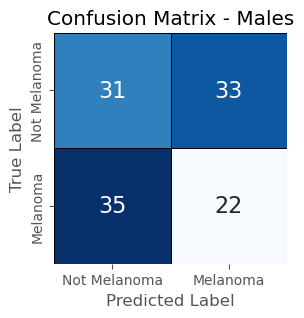

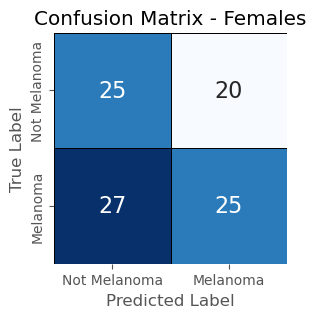

In [20]:
# Visualize confusion matrix for males
plt.figure(figsize=(3, 3))

# Add labels melanoma and not melanoma
sns.heatmap(confusion_matrix_male, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Not Melanoma", "Melanoma"], yticklabels=["Not Melanoma", "Melanoma"])
plt.title('Confusion Matrix - Males')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Visualize confusion matrix for females
plt.figure(figsize=(3, 3))
sns.heatmap(confusion_matrix_female, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Not Melanoma", "Melanoma"], yticklabels=["Not Melanoma", "Melanoma"])
plt.title('Confusion Matrix - Females')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


In [21]:
# Combine the data into a DataFrame
data_male = pd.DataFrame({'prediction': np.array(y_male_pred).flatten(), 'true_label': np.array(y_male_true).flatten(), 'group': 'male'})
data_female = pd.DataFrame({'prediction': np.array(y_female_pred).flatten(), 'true_label': np.array(y_female_true).flatten(), 'group': 'female'})
data = pd.concat([data_male, data_female])

data

,prediction,true_label,group
0,1,0,male
1,0,0,male
2,0,0,male
3,1,0,male
4,1,0,male
...,...,...,...
92,1,1,female
93,1,1,female
94,0,1,female
95,1,1,female


<br>

##### Step 12 - Load Fairness Metrics into Group Fairness Taxonomy Function

Load the group fairness metrics into the taxonomy function. We advise you to incorporate the following metrics:

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/suggested_fairness_compas_1.png" width=1000>
    <img src="./assets/suggested_fairness_compas_2.png" width=1000>
</div>

__ANSWER:__

In [22]:
# False positive (FP) rate
def false_positive_rate(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return fp / (fp + tn) if (fp + tn) > 0 else 0

# False negative (FN) rate
def false_negative_rate(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return fn / (fn + tp) if (fn + tp) > 0 else 0

In [23]:
# Metric #1 - Equalized odds
def equalized_odds(data):
    equalized_odds_values = data.groupby('group').apply(lambda df: {
        'FPR': false_positive_rate(df['true_label'], df['prediction']),
        'FNR': false_negative_rate(df['true_label'], df['prediction'])
    })
    return equalized_odds_values

equalized_odds(data)

group
female    {'FPR': 0.4444444444444444, 'FNR': 0.519230769...
male           {'FPR': 0.515625, 'FNR': 0.6140350877192983}
dtype: object

In [24]:
# Metric #2 - Demographic parity 
def demographic_parity(data):
    positive_rates = data.groupby('group')['prediction'].mean()
    return positive_rates

demographic_parity(data)

group
female    0.463918
male      0.454545
Name: prediction, dtype: float64

In [25]:
# Metric #3 - Equal selection parity
def equal_selection_parity(data):
    selection_rates = data.groupby('group')['prediction'].mean()
    return abs(selection_rates.diff().iloc[-1])

equal_selection_parity(data)

0.009372071227741363

In [26]:
# Metric #4 - Conditional statistics parity
def conditional_statistics_parity(data, explaining_variable='explaining_variable'):
    conditional_rates = data.groupby(['group', explaining_variable])['prediction'].mean()
    return conditional_rates.groupby('group').std()

conditional_statistics_parity(data, explaining_variable='group')

group
female   NaN
male     NaN
Name: prediction, dtype: float64

In [27]:
# Metric #5 - Calibration
def calibration(data):
    calibration_values = data.groupby('group').apply(
        lambda df: np.abs(df['prediction'] - df['true_label']).mean())
    return calibration_values

calibration(data)

group
female    0.484536
male      0.561983
dtype: float64

In [28]:
# Metric #6 - Conditional use accuracy equality
def conditional_use_accuracy_equality(data):
    # Correctly comparing within each group
    conditional_accuracies = data.groupby(['group', 'true_label']).apply(
        lambda group: np.mean(group['prediction'] == group['true_label']))
    return conditional_accuracies.groupby('group').std()

conditional_use_accuracy_equality(data)

group
female    0.052882
male      0.069586
dtype: float64

In [29]:
# Metric #7 - Equalized opportunities
def equalized_opportunities(data):
    fnr_diff = data.groupby('group').apply(
        lambda df: false_negative_rate(df['true_label'], df['prediction']))
    return abs(fnr_diff.diff().iloc[-1])

equalized_opportunities(data)

0.094804318488529

In [30]:
# Metric #8 - Predictive equality
def predictive_equality(data):
    fpr_diff = data.groupby('group').apply(
        lambda df: false_positive_rate(df['true_label'], df['prediction']))
    return abs(fpr_diff.diff().iloc[-1])

predictive_equality(data)

0.07118055555555558

In [31]:
# Metric #9 - Balance for positive class
def balance_for_positive_class(data):
    average_scores = data[data['true_label'] == 1].groupby('group')['prediction'].mean()
    return abs(average_scores.diff().iloc[-1])

balance_for_positive_class(data)

0.09480431848852905

In [32]:
# Metric #10 - Balance for negative class 
def balance_for_negative_class(data):
    average_scores = data[data['true_label'] == 0].groupby('group')['prediction'].mean()
    return abs(average_scores.diff().iloc[-1])

balance_for_negative_class(data)

0.07118055555555558

In [33]:
# Metric #11 - Predictive parity
def predictive_parity(data):
    precision_values = data.groupby('group').apply(
        lambda df: precision_score(df['true_label'], df['prediction']))
    return precision_values

predictive_parity(data)

group
female    0.555556
male      0.400000
dtype: float64

<br>

##### Step 13 - Control Flow in Group Fairness Taxonomy Function

Create a control flow for the group fairness taxonomy function by incorporating conditional statements (e.g., if-else statements).

__ANSWER:__


In [53]:
def fairness_compass(
        policy, representation_type, equal_base_rate, ground_truth_available, explaining_variable,
        suitable_evaluation_metric, output_type, error_type, sensitive_class, 
    ):
    """
    Function for computing fairness metrics based on the fairness compass.

    ARGUMENTS
    ===================================================
        - policy (bool): Is there any anit-discriination policy or laws in place? 
        - representation_type (str): Type of representation (i.e., equal number or proportion)
        - equal_base_rate (bool): Is the base rate equal across the groups?
        - ground_truth_available (bool): Is the ground truth available?
        - explaining_variable (bool): If data shows reasons for unequal treatment across groups, this can be justified. For example, if a discriminated group that gets paid less works fewer hours, then this is justified.
        - error_type (str): Type of error that is most sensitive to the fairness attribute.

    """

    # Metric 1 - Equal selection parity
    if (policy==True) & (representation_type=="equal number"):
        out = equal_selection_parity(data)
        print("Based on the given arugument, the metric 1 has been selected.")
        print("Equal selection parity: ", out)

    # Metric 2 - Demographic parity
    elif ((policy==True) & (representation_type=="proportion")) or \
       ((policy==False) & (equal_base_rate==True)) or \
       ((policy==False) & (equal_base_rate==False) & (ground_truth_available==False) & (explaining_variable==False)):
        out = demographic_parity(data)
        print("Based on the given arugument, the metric 2 has been selected.")
        print("Demographic parity: ", out)

    # Metric 3 - Conditional statistical parity
    elif (policy==False) & (equal_base_rate==False) & (ground_truth_available==False) & (explaining_variable==True):
        out = conditional_statistics_parity(data)
        print("Based on the given arugument, the metric 3 has been selected.")
        print("Conditional statistical parity: ", out)

    # Metric 4 - Calibration
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="precision") & (output_type=="score")):
        out = calibration(data)
        print("Based on the given arugument, the metric 4 has been selected.")
        print("Calibration: ", out)

    # Metric 5 - Conditional use accuracy equality
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="precision") & (output_type=="class label") & (error_type=="FN + FP")):
        out = conditional_use_accuracy_equality(data)
        print("Based on the given arugument, the metric 5 has been selected.")
        print("Conditional use accuracy equality: ", out)

    # Metric 6 - Predictive parity
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="precision") & (output_type=="class label") & (error_type=="FP")):
        out = predictive_parity(data)
        print("Based on the given arugument, the metric 6 has been selected.")
        print("Predictive parity: ", out)

    # Metric 7 - Equalized odds
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="recall") & (output_type=="class label") & (error_type=="FN + FP")):
        out = equalized_odds(data)
        print("Based on the given arugument, the metric 7 has been selected.")
        print("Equalized odds: ", out)

    # Metric 8 - Equalized opportunity
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="recall") & (output_type=="class label") & (error_type=="FN")):
        out = equalized_opportunities(data)
        print("Based on the given arugument, the metric 8 has been selected.")
        print("Equalized opportunity: ", out)

    # Metric 9 - Predictive equality
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="recall") & (output_type=="class label") & (error_type=="FP")):
        out = predictive_equality(data)
        print("Based on the given arugument, the metric 9 has been selected.")
        print("Predictive equality: ", out)

    # Metric 10 - Balance for positive classes
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="recall") & (output_type=="score") & (sensitive_class=="positive class")):
        out = balance_for_positive_class(data)
        print("Based on the given arugument, the metric 10 has been selected.")
        print("Balance for positive classes: ", out)

    # Metric 11 - Balance for negative classes
    elif ((policy==False) & (equal_base_rate==False) & (ground_truth_available==True) & (suitable_evaluation_metric=="recall") & (output_type=="score") & (sensitive_class=="negative class")):
        out = balance_for_negative_class(data)
        print("Based on the given arugument, the metric 11 has been selected.")
        print("Balance for negative classes: ", out)

    # Metric N - Else
    else:
        print("Did not match any metrics.")

    # return out

In [54]:
fairness_compass(
    policy = False,
    equal_base_rate = False,
    ground_truth_available = True,
    suitable_evaluation_metric = "recall",
    output_type = "class label",
    error_type = "FN",
    representation_type=None,
    explaining_variable=None,
    sensitive_class=None,
)

Based on the given arugument, the metric 8 has been selected.
Equalized opportunity:  0.0156462585034014


<br>

##### Step 14 - Elaboration

Elaborate on your approach, the choices you made, and the results of the fairness evaluation (e.g., determination of suitable group fairness metric, the outcome of group fairness metric calculation, etc.).

__ANSWER:__

- Value 0.0156462585034014: Indicates a minor disparity in the model's performance between groups. A small value suggests relatively fair outcomes, but some difference still exists.
- Application: Ensures a model is equally accurate in predicting positive outcomes for all groups. Critical in areas like hiring or loan approvals to avoid bias.
- Implication for Data Scientists: This value should be assessed to decide if the model fairness is acceptable or needs further tuning.

<br>

<h1 style="text-align:center;"> Section 2B - Responsible AI </h1>



<br>

## Task 2.6: Apply Explainable AI (XAI) Methods to Image Classifier

---

__Explainable AI (XAI)__ involves techniques that make AI systems’ decisions and workings understandable to humans, ensuring transparency in increasingly complex AI applications.

<br>

##### 2.6.1. Trade-off Between Accuracy vs. Interpretability


The trade-off between accuracy and interpretability is that highly accurate models, often lack transparency in how they make decisions, while simpler, more interpretable models may not capture complex patterns as effectively. The choice between the two depends on whether the priority is understanding the decision-making process or achieving the highest accuracy.

In a skin cancer classification task, accuracy is usually more important because it's crucial to correctly diagnose cancer. However, some interpretability is also helpful so doctors can understand and trust the model’s decisions.


<br>

##### 2.6.2. Choose and Apply XAI Methods and 

In this sectoin, we will use Explainable AI (XAI) techniques like LIME and KernelShap to generate and display explanations for the model's decision, enhancing transparency and understanding.

In [13]:
# Load the best weights for model 1
model = keras.models.load_model("./models/best_model_iteration_2.h5")

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_617 (Conv2D)         (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 111, 111, 32)     0         
 g2D)                                                            
                                                                 
 batch_normalization_613 (Ba  (None, 111, 111, 32)     128       
 tchNormalization)                                               
                                                                 
 conv2d_618 (Conv2D)         (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 54, 54, 64)       0         
 g2D)                                                            
                                                      

In [22]:
### Load X and y for "Benign keratosis" (class 0)

# Load and preproess the image
x_benign_keratosis = np.expand_dims(tf.keras.preprocessing.image.load_img("./data/processed/train/Benign keratosis/ISIC_0024494.jpg", target_size=(224, 224)), 0)
x_benign_keratosis = np.array(x_benign_keratosis, dtype=np.float32) / 255.0

# Set output 
# {'Benign keratosis': 0, 'Melanocytic nevi': 1, 'Melanoma': 2}
y_benign_keratosis = np.expand_dims(tf.keras.utils.to_categorical(0, 3), 0)                # 0 is the index for correct class, 3 is total number of classes


### Load X and y for "Melanocytic nevi" (class 1)

# Load and preproess the image
x_melanocytic_nevi = np.expand_dims(tf.keras.preprocessing.image.load_img("./data/processed/train/Melanocytic nevi/ISIC_0024507.jpg", target_size=(224, 224)), 0)
x_melanocytic_nevi = np.array(x_melanocytic_nevi, dtype=np.float32) / 255.0

# Set output 
# {'Benign keratosis': 0, 'Melanocytic nevi': 1, 'Melanoma': 2}
y_melanocytic_nevi = np.expand_dims(tf.keras.utils.to_categorical(1, 3), 0)                # 1 is the index for correct class, 3 is total number of classes


### Load X and y for "Melanoma" (class 2)

# Load and preproess the image
x_melanoma = np.expand_dims(tf.keras.preprocessing.image.load_img("./data/processed/test/Melanoma/ISIC_0025219.jpg", target_size=(224, 224)), 0)
x_melanoma = np.array(x_melanoma, dtype=np.float32) / 255.0

# Set output 
# {'Benign keratosis': 0, 'Melanocytic nevi': 1, 'Melanoma': 2}
y_melanoma = np.expand_dims(tf.keras.utils.to_categorical(2, 3), 0)                # 2 is the index for correct class, 3 is total number of classes

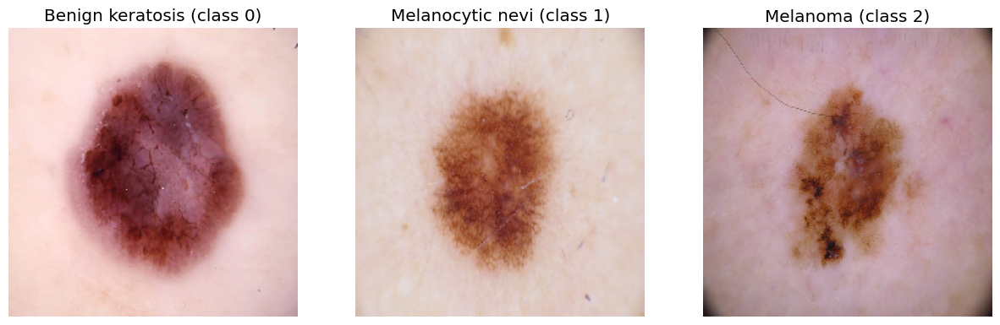

In [23]:
# Set the figure size
plt.rcParams["figure.figsize"] = [15, 5]

# Create a subplot with 1 row and 3 columns
fig, axs = plt.subplots(1, 3)

# Plot the images
axs[0].imshow(x_benign_keratosis[0])
axs[0].axis('off')
axs[0].set_title('Benign keratosis (class 0)')

axs[1].imshow(x_melanocytic_nevi[0])
axs[1].axis('off')
axs[1].set_title('Melanocytic nevi (class 1)')

axs[2].imshow(x_melanoma[0])
axs[2].axis('off')
axs[2].set_title('Melanoma (class 2)')

# Show the plot
plt.show()

In [24]:
# Create a dictionary with the image data and labels
data = {
    'Benign keratosis': (x_benign_keratosis, y_benign_keratosis),
    'Melanocytic nevi': (x_melanocytic_nevi, y_melanocytic_nevi),
    'Melanoma': (x_melanoma, y_melanoma)
}

In [25]:
# Parameters for all XAI methods (i.e., LIME and KernelSHAP)
common_parameters = {
    "model": model,
    "batch_size": 16,
    "map_to_interpret_space": None, 
    "nb_samples": 4000,
    "ref_value": None,  
}

In [26]:
# Parameters for LIME
lime_specific_parameters = {
    "interpretable_model": linear_model.Ridge(alpha=2),
    "similarity_kernel": None,  
    "pertub_func": None,  
    "distance_mode": "euclidean", 
    "kernel_width": 45.0,  
    "prob": 0.5, 
}

In [27]:
# Instanciate one explainer for each method
explainers = {
    "Lime": Lime(**common_parameters, **lime_specific_parameters),
    "KernelShap": KernelShap(**common_parameters),
}

Lime - Benign keratosis


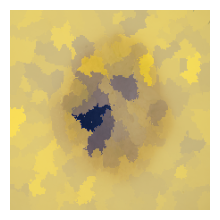

Lime - Melanocytic nevi


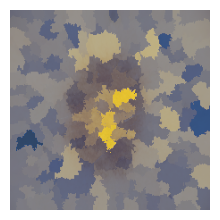

Lime - Melanoma


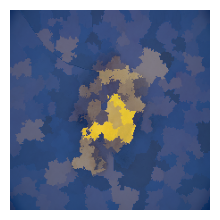

KernelShap - Benign keratosis


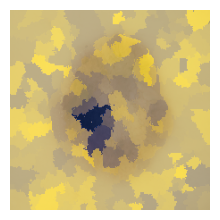

KernelShap - Melanocytic nevi


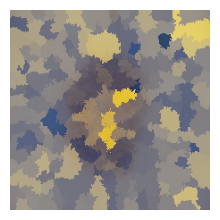

KernelShap - Melanoma


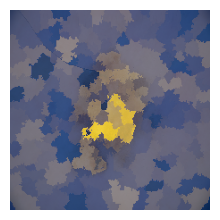

In [28]:
# Assume 'explainers' is a dictionary of different explainers
for explainer_name, explainer in explainers.items():

    # Iterate over all classes
    for idx, (class_name, (x, y)) in enumerate(data.items()):

        # Compute explanation by calling the explainer
        explanation = explainer.explain(x, y)

        # Visualize explanation with plot_attributions() function
        print(f"{explainer_name} - {class_name}")
        plot_attributions(explanation, x, img_size=2, cmap='cividis', cols=1, alpha=0.8)
        plt.show()

<br>

##### 2.6.3. Result Assessment

Ensure explanations are clear and meaningful:

- LIME and KernelSHAP outputs highlight regions in skin lesion images that are most influential for the model's predictions. 
- LIME suggests more centralized features are important for "Benign keratosis," while for "Melanocytic nevi" and "Melanoma," the influential features are more dispersed.


Identify decision-making patterns in the model's explanations:

- Both methods consistently highlight central regions as important, but KernelSHAP shows a broader influence zone around these areas. 
- The model seems to use central features for "Benign keratosis" and more complex patterns for "Melanoma."


<br>

<h1 style="text-align:center;">  Section 3 - Neural Networks and Deep Learning </h1>



<br>

## Task 3.1: Baselines

---

<br>

### 1. Random Guess Accuracy

If you are guessing randomly between three different categories, assuming each one is equally likely, your chances of guessing correctly are approximately 33.33%. This is because, on average, you would be correct one out of every three guesses.

$$ \text{Accuracy} = \frac{\text{1}}{\text{Number of Classes}} = \frac{1}{3} \approx 33.33\% $$


<br>

### 2. Human-Level Performance Accuracy

The study involved four students with no prior knowledge of skin cancer recognition. They were asked to classify three different types of skin cancer using only image observation. Each type of cancer was represented by 10 images, making a total of 30 images for the study. In this study, the following form was used to test the candidates:

<div style="text-align: center;">
    <img width="500px" src="./assets/HLP_test.png">
</div>

Link for the test: https://forms.office.com/e/epjNm6LRrX

In the table below, the results of the study are presented. The 'Id' column represents the student number, and the adjacent column shows the number of correct answers out of a total of 30 available answers.

<div style="text-align: center; margin-left: auto; margin-right: auto; width: 25%;">
    <table style="width:70%; border:1px solid black;">
        <thead>
            <tr style="background-color:#aa69fa;">
                <th style="border:1px solid black; padding:5px; text-align:center;">Id</th>
                <th style="border:1px solid black; padding:5px; text-align:center;">Total Points</th>
            </tr>
        </thead>
        <tbody>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">1</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">12/30</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">2</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">12/30</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">3</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">11/30</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">4</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">10/30</td>
            </tr>
        </tbody>
    </table>
</div>

This suggests that the human-level accuracy among these four students is 37.5%. This number is very close to a random gussing.


$$ \text{Accuracy} = \frac{\sum \text{Correct Predictions}}{\text{Total Predictions}} = \frac{(12 + 12 + 11 + 10)}{30 \times 4} = \frac{45}{120} = 37.5\% $$


<br>

### 3. Basic Multilayer Perceptron Accuracy

A Multilayer Perceptron (MLP) is a type of artificial neural network model composed of at least three layers of nodes: an input layer, one or more hidden layers, and an output layer. When applying an MLP to train the dataset, the best accuracy is measured at $48.92\%$ (with learning rate of 0.001).

In [39]:
# Load data
train_datagen = ImageDataGenerator(rescale=1./255,)
train_generator = train_datagen.flow_from_directory('data/processed/train/', target_size=(224, 224), batch_size=32, class_mode='categorical')

val_datagen = ImageDataGenerator(rescale = 1./255)
validation_generator = val_datagen.flow_from_directory('data/processed/validation/', target_size=(224, 224), batch_size=32, class_mode='categorical')

test_datagen = ImageDataGenerator(rescale = 1./255)
test_generator = test_datagen.flow_from_directory('data/processed/test/', target_size=(224, 224), batch_size=32, class_mode='categorical')

Found 2307 images belonging to 3 classes.
Found 663 images belonging to 3 classes.
Found 327 images belonging to 3 classes.


In [40]:
# Create a MLP model for baseline 
def create_model():

    # Create a Sequential model
    baseline_model = keras.models.Sequential()

    # Input layer 
    baseline_model.add(keras.layers.InputLayer(input_shape=(224, 224, 3)))
    baseline_model.add(keras.layers.Flatten())

    # Hidden layers
    baseline_model.add(keras.layers.Dense(units=512, activation='relu', name='hidden_layer_1'))

    # Output layer
    baseline_model.add(keras.layers.Dense(units=3, activation='softmax', name='output_layer'))

    return baseline_model

In [41]:
# Define different learning rates for checking
learning_rates = [0.1, 0.01, 0.001]

In [43]:
# Initialize a dictionary to store the history for each learning rate
histories = {}

# Loop over the learning rates
for lr in learning_rates:

    print(f"\nTraining model with learning rate: {lr}")

    # Create a new model
    model = create_model()

    # Compile the model
    model.compile(loss='binary_crossentropy',  # Adjust for your specific use case
                  optimizer=keras.optimizers.Adam(learning_rate=lr),
                  metrics=['accuracy'])
    
    # Early stopping callback
    early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)

    # Train the model
    history = model.fit(train_generator, validation_data=validation_generator, epochs=10, verbose=0, callbacks=[early_stopping])  

    # Store the history
    histories[lr] = history

    # Evaluate the model
    loss, accuracy = model.evaluate(test_generator, verbose=0)  
    print(f"Test loss: {loss}")
    print(f"Test accuracy: {accuracy}")


Training model with learning rate: 0.1


Test loss: 0.6374762058258057
Test accuracy: 0.3333333432674408

Training model with learning rate: 0.01
Test loss: 0.6365299224853516
Test accuracy: 0.3302752375602722

Training model with learning rate: 0.001
Test loss: 1.795853614807129
Test accuracy: 0.48929664492607117


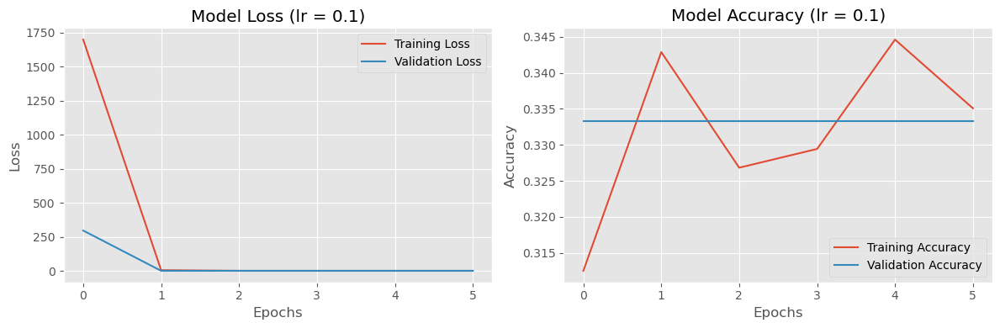

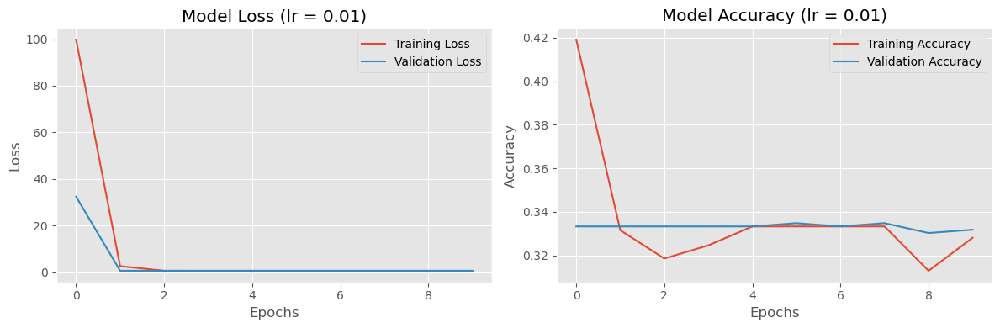

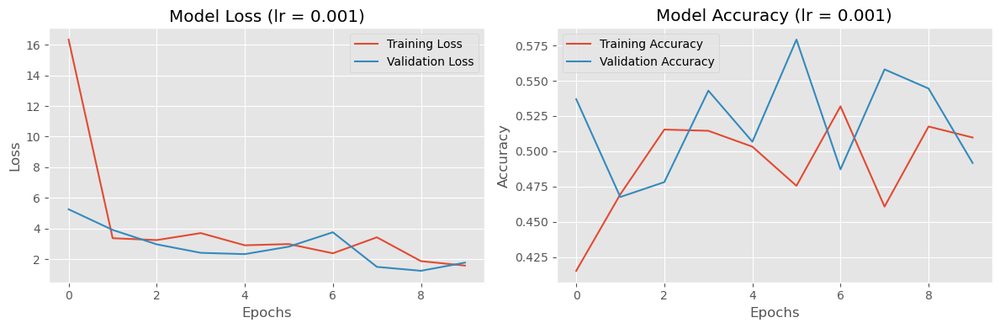

In [44]:
# Plot the learning curves

for lr, history in histories.items():
    
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Model Loss (lr = {lr})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Model Accuracy (lr = {lr})')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

<br>

## Tasks 3.2 - 3.6: Preprocessing, CNN Architecture, Training, Performance, Error Analysis

---

In this section, we will train CNN models and improve them through four different iterations. Based on the given instructions, we will use the following plan for each iteration.

<div style="text-align: center; margin-left: auto; margin-right: auto; width: 50%;">
    <table style="width:70%; border:1px solid black;">
        <thead>
            <tr style="background-color:#aa69fa;">
                <th style="border:1px solid black; padding:5px; text-align:center;">Iteration Number</th>
                <th style="border:1px solid black; padding:5px; text-align:center;">Augmentation</th>
                <th style="border:1px solid black; padding:5px; text-align:center;">Model</th>
            </tr>
        </thead>
        <tbody>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">1</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">No</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Simple model</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">2</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Yes</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Simple model</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">3</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">No</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Transfer learning</td>
            </tr>
            <tr>
                <td style="border:1px solid black; padding:5px; text-align:center;">4</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Yes</td>
                <td style="border:1px solid black; padding:5px; text-align:center;">Transfer learning</td>
            </tr>
        </tbody>
    </table>
</div>

<mark>NOTE:</mark> For better readability, the headers have been reorganized to present a more logical order for iterations.

<br>

## ⭐ Iteration 1 ⭐


<br>

### 1.1. Preprocessing (Iteration #1)

The code creates image data generators for training, validation, and testing sets in a neural network without using any data augmentation methods. It sets specific image dimensions and batch size, rescales images, and loads them from designated directories for multi-class classification.


In [4]:
# Parameters
image_height, image_width, num_channels = 224, 224, 3
batch_size = 32
rescale_ratio = 1./255

# Data generator for training set
train_datagen_1 = ImageDataGenerator(rescale = rescale_ratio)
train_generator_1 = train_datagen_1.flow_from_directory(
    'data/processed/train/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for validation set
val_datagen_1 = ImageDataGenerator(rescale = rescale_ratio)
validation_generator_1 = val_datagen_1.flow_from_directory( 
    'data/processed/validation/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for testing set
test_datagen_1 = ImageDataGenerator(rescale = rescale_ratio)
test_generator_1 = test_datagen_1.flow_from_directory( 
    'data/processed/test/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

Found 2307 images belonging to 3 classes.


Found 663 images belonging to 3 classes.
Found 327 images belonging to 3 classes.


<br>

### 1.2. CNN Architecture (Iteration #1)

The code builds a Keras sequential neural network with two CNN layers, max pooling, batch normalization, and dropout for regularization. It includes a fully connected and a softmax output layer for three-class classification. Compiled with Adam optimizer and categorical crossentropy, it tracks accuracy and other key metrics. 

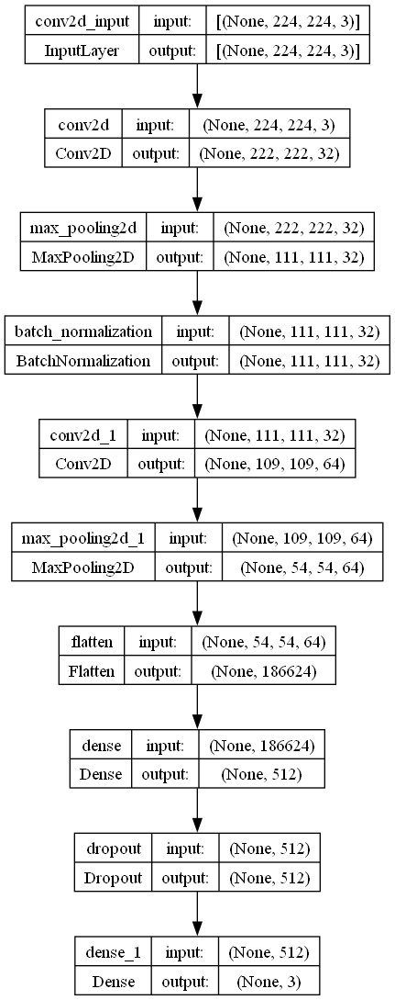

In [5]:
# Create a Sequential model
model_1 = keras.models.Sequential()

# Add layer 1 (convolutional layer + max pooling layer + batch normalization)
model_1.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(image_height, image_width, 3)))
model_1.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_1.add(keras.layers.BatchNormalization())

# Add layer 2 (convolutional layer + max pooling layer)
model_1.add(keras.layers.Conv2D(64, (3, 3), activation='relu'))
model_1.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))

# Flatten the layer
model_1.add(keras.layers.Flatten())

# Add the first fully connected layer + dropout
model_1.add(keras.layers.Dense(512, activation='relu'))
model_1.add(keras.layers.Dropout(0.2))

# Add the output layer
model_1.add(keras.layers.Dense(3, activation='softmax'))

# Compile the model
model_1.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', 'Precision', 'Recall', 'AUC'])

# Print the model summary
# model_1.summary()

# Plot the model
keras.utils.plot_model(model_1, show_shapes=True)

<br>

### 1.3. CNN Training (Iteration #1)

The code trains a Keras model with callbacks for early stopping, optimal model checkpointing, and learning rate reduction on plateaus. It trains for up to 10 epochs using specified data generators, and saves the final model weights after completion.


In [26]:
# List of callbacks
callbacks = [
    keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    keras.callbacks.ModelCheckpoint("./models/best_model_iteration_1.h5", save_best_only=True),
    keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=3)
]

# Train the model
history = model_1.fit(
    train_generator_1,
    epochs=10,
    validation_data=validation_generator_1,
    callbacks=callbacks
)

# Save the last weights
model_1.save("./models/last_model_iteration_1.h5")

Epoch 1/10
73/73 [==============================] - 91s 1s/step - loss: 9.8050 - accuracy: 0.5115 - precision: 0.5300 - recall: 0.4595 - auc: 0.6579 - val_loss: 1.0475 - val_accuracy: 0.4661 - val_precision: 0.7600 - val_recall: 0.0860 - val_auc: 0.6390 - lr: 0.0010
Epoch 2/10
73/73 [==============================] - 97s 1s/step - loss: 0.7817 - accuracy: 0.6615 - precision: 0.7463 - recall: 0.5011 - auc: 0.8344 - val_loss: 1.0255 - val_accuracy: 0.4887 - val_precision: 0.7714 - val_recall: 0.1629 - val_auc: 0.6345 - lr: 0.0010
Epoch 3/10
73/73 [==============================] - 69s 940ms/step - loss: 0.6970 - accuracy: 0.6914 - precision: 0.7681 - recall: 0.5830 - auc: 0.8692 - val_loss: 1.0496 - val_accuracy: 0.4691 - val_precision: 0.7288 - val_recall: 0.0649 - val_auc: 0.6358 - lr: 0.0010
Epoch 4/10
73/73 [==============================] - 97s 1s/step - loss: 0.6176 - accuracy: 0.7365 - precision: 0.7980 - recall: 0.6541 - auc: 0.8985 - val_loss: 1.0111 - val_accuracy: 0.4902 - val

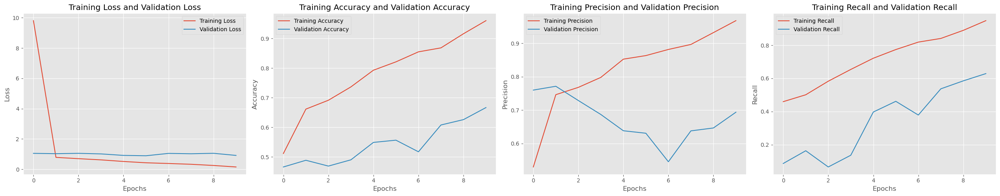

In [30]:
metrics = [
    ('loss', 'Loss'), 
    ('accuracy', 'Accuracy'), 
    ('precision', 'Precision'), 
    ('recall', 'Recall'), 
]
plt.figure(figsize=(25, 5))

for i, (metric, label) in enumerate(metrics, 1):
    plt.subplot(1, 4, i)
    plt.plot(history.history[metric], label=f'Training {label}')
    plt.plot(history.history[f'val_{metric}'], label=f'Validation {label}')
    plt.legend()
    plt.title(f'Training {label} and Validation {label}')
    plt.xlabel('Epochs')
    plt.ylabel(label)

plt.tight_layout()
plt.show()

<br>

### 1.4. Model Performance (Iteration #1)

The code loads the best-performing Keras model and evaluates it on training, validation, and test sets, visualizing metrics like loss, accuracy, precision, recall, and AUC as gauge charts. It also plots the model's training history, comparing training and validation performance across different metrics over the epochs, providing a clear visual representation of the model's performance.


In [6]:
# Load the best weights for model 1
model_1 = keras.models.load_model("./models/best_model_iteration_1.h5")

11/11 [==============================] - 3s 252ms/step


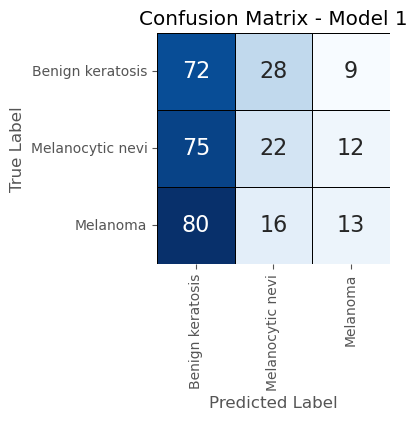

In [10]:
# Confusion matrix
y_pred = model_1.predict(test_generator_1)

# Convert predictions to binary
y_pred = np.argmax(y_pred, axis=1)

# True labels
y_true = test_generator_1.classes

# Confusion matrix
confusion_matrix_1 = confusion_matrix(y_true, y_pred)

# Visualize confusion matrix
plt.figure(figsize=(3, 3))
sns.heatmap(confusion_matrix_1, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"], yticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"])
plt.title('Confusion Matrix - Model 1')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [7]:
# Function for plotting the metrics (gauge chart)
def plot_metrics_gauge_charts(metrics, values, title):
    fig = go.Figure([go.Indicator( mode = "gauge+number", value = val * 100, title = {'text': metric, 'font': {'size': 16}}, domain = {'x': [1/5 * i + 0.02, 1/5 * (i + 1) - 0.03], 'y': [0.1, 0.7]}, number={'suffix': "%", 'font': {'size': 24}}, gauge={'axis': {'range': [None, 100]}}) for i, (metric, val) in enumerate(zip(metrics, values))])
    fig.update_layout(title=title, paper_bgcolor="lavender", font={"color": "RebeccaPurple", "family": "Arial", "size":15}, height=300).show()

In [9]:
# List of data generators
generator_splits = ['train_generator_1', 'validation_generator_1', 'test_generator_1']

# Iterate over the generator splits
for generator in generator_splits:

    # Evaluate the model on the current generator
    loss, accuracy, precision, recall, auc = model_1.evaluate(eval(generator))

    # Plot the metrics
    plot_metrics_gauge_charts(
        metrics = ['Loss', 'Accuracy', 'Precision', 'Recall', 'AUC'], values = [loss, accuracy, precision, recall, auc], title = f"Model Metrics for {generator.split('_')[0].capitalize()} Set",
    )

73/73 [==============================] - 76s 1s/step - loss: 0.7275 - accuracy: 0.6511 - precision: 0.7675 - recall: 0.5310 - auc: 0.8608


21/21 [==============================] - 19s 921ms/step - loss: 0.8895 - accuracy: 0.5566 - precision: 0.6309 - recall: 0.4615 - auc: 0.7679


11/11 [==============================] - 13s 1s/step - loss: 0.9257 - accuracy: 0.5474 - precision: 0.6303 - recall: 0.4067 - auc: 0.7525


__RESULT:__ <br>

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Metric</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Training Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Validation Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Test Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Interpretation</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Loss</td>
            <td style="border:1px solid black; padding:10px;">0.7275</td>
            <td style="border:1px solid black; padding:10px;">0.8895</td>
            <td style="border:1px solid black; padding:10px;">0.9257</td>
            <td style="border:1px solid black; padding:10px;">The model exhibits an increase in loss from training to validation and test sets, suggesting a potential overfitting or generalization issue.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Accuracy</td>
            <td style="border:1px solid black; padding:10px;">65.11%</td>
            <td style="border:1px solid black; padding:10px;">55.66%</td>
            <td style="border:1px solid black; padding:10px;">54.74%</td>
            <td style="border:1px solid black; padding:10px;">A decline in accuracy from training to validation and test sets indicates reduced model effectiveness on unseen data.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Precision</td>
            <td style="border:1px solid black; padding:10px;">76.75%</td>
            <td style="border:1px solid black; padding:10px;">63.09%</td>
            <td style="border:1px solid black; padding:10px;">63.03%</td>
            <td style="border:1px solid black; padding:10px;">The decrease in precision from training to validation and test sets suggests the model is less effective at predicting true positives in new data.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Recall</td>
            <td style="border:1px solid black; padding:10px;">53.10%</td>
            <td style="border:1px solid black; padding:10px;">46.15%</td>
            <td style="border:1px solid black; padding:10px;">40.67%</td>
            <td style="border:1px solid black; padding:10px;">A decreasing recall rate across datasets indicates the model's diminishing ability to correctly identify all actual positives.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">AUC</td>
            <td style="border:1px solid black; padding:10px;">86.08%</td>
            <td style="border:1px solid black; padding:10px;">76.79%</td>
            <td style="border:1px solid black; padding:10px;">75.25%</td>
            <td style="border:1px solid black; padding:10px;">The AUC score decreases from training to validation and test sets, indicating a decline in the model's overall classification performance on unseen data.</td>
        </tr>
    </tbody>
</table>

__BASELINE COMPARISON:__

Upon comparing the accuracy of model_1 with the baseline, it is observed that there has been an improvement from $48.92\%$ to $54.74\%$.

<br>

### 1.5. Error Analysis (Iteration #1)

The code is for error analysis in a machine learning model. It loads a pre-trained model, identifies misclassified images in a test set, visualizes error distributions, and displays the misclassified images for further examination.








In [12]:
# Load the best model
model_1 = load_model('./models/best_model_iteration_1.h5')

In [15]:
# Function for getting the misclassified instances
def get_misclassified_instances(model, metadata):

    # Test set info from metadata
    test_set_df = metadata[metadata["split"] == "test"]

    # Loop over the metadata
    for i_index, i_row in tqdm(test_set_df.iterrows(), total=test_set_df.shape[0], colour="green", ncols=100):

        # Image
        img = keras.preprocessing.image.load_img(i_row["image path"], target_size=(224, 224))   # Load the image
        img = keras.preprocessing.image.img_to_array(img)                                       # Convert to numpy array
        img = img / 255.0                                                                       # Normalize the image
        img = np.expand_dims(img, axis=0)                                                       # Convert to batch

        # Predict the image
        pred = model.predict(img, verbose=0)

        # Predicted class int and name
        pred_class = np.argmax(pred)
        pred_class_name = test_set_df["lesion_type"].unique()[pred_class]

        # Add the predicted class to the metadata
        test_set_df.at[i_index, 'predicted class'] = int(pred_class)
        test_set_df.at[i_index, 'predicted class name'] = pred_class_name

    # Get the misclassified instances
    metadata_misclassified = test_set_df[test_set_df["label"] != test_set_df["predicted class"]]

    return metadata_misclassified

In [18]:
# Get the misclassified instances
misclassified_instances = get_misclassified_instances(model_1, metadata)

misclassified_instances

100%|█████████████████████████████████████████████████████████████| 327/327 [00:27<00:00, 11.69it/s]


,lesion_id,image_id,dx,dx_type,age,sex,localization,label,lesion_type,image path,split,predicted class,predicted class name
25,HAM_0004566,ISIC_0029394,bkl,histo,55.0,female,lower extremity,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
29,HAM_0003206,ISIC_0032365,bkl,histo,60.0,female,lower extremity,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
52,HAM_0000920,ISIC_0028707,bkl,histo,60.0,male,upper extremity,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
55,HAM_0007101,ISIC_0032618,bkl,histo,60.0,male,lower extremity,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
75,HAM_0006670,ISIC_0027335,bkl,histo,75.0,male,back,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3236,HAM_0003386,ISIC_0032662,mel,histo,70.0,male,abdomen,4,Melanoma,./data/processed/test/Melanoma/ISIC_0032662.jpg,test,2.0,Melanoma
3245,HAM_0004047,ISIC_0030277,mel,histo,55.0,female,upper extremity,4,Melanoma,./data/processed/test/Melanoma/ISIC_0030277.jpg,test,0.0,Benign keratosis
3251,HAM_0006376,ISIC_0033662,mel,histo,70.0,female,lower extremity,4,Melanoma,./data/processed/test/Melanoma/ISIC_0033662.jpg,test,0.0,Benign keratosis
3260,HAM_0004813,ISIC_0027063,mel,histo,80.0,male,abdomen,4,Melanoma,./data/processed/test/Melanoma/ISIC_0027063.jpg,test,2.0,Melanoma


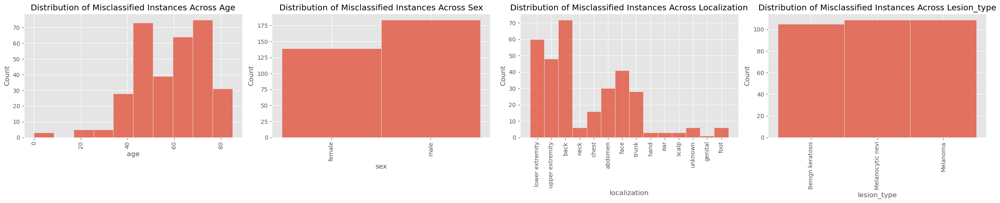

In [19]:
### Frequency of errors in different features

# Create a single row of 4 subplots, with a total figure size of 24x5 inches
fig, axs = plt.subplots(1, 4, figsize=(24, 5))

# Loop over the list of categories
for i, category in enumerate(['age', 'sex', 'localization', 'lesion_type']):
    
    # Select the subplot to plot on
    ax = axs[i]
    
    # Create a histogram of the current category, using the misclassified instances data
    sns.histplot(data=misclassified_instances, x=category, bins=10, ax=ax)
    
    # Set the title of the subplot
    ax.set_title(f'Distribution of Misclassified Instances Across {category.capitalize()}')
    
    # Rotate the x-axis labels by 90 degrees
    ax.tick_params(axis='x', rotation=90)

# Adjust the layout so that the subplots do not overlap
plt.tight_layout()

# Display the figure
plt.show()

In [20]:

# Function for visualizing all misclassified images
def visualize_all_misclassified_images(misclassified_instances):

    # List of unique labels
    classes = misclassified_instances['lesion_type'].unique()

    # Loop over the classes
    for class_label in classes:

        # Report
        print(f"All images for class ''{class_label}'' that were misclassified in test set:")

        # Filter the misclassified instances by class
        metadata_class = misclassified_instances[misclassified_instances['lesion_type'] == class_label]

        # Determine the number of rows needed
        rows = math.ceil(len(metadata_class) / 20)

        # Create a new figure
        plt.figure(figsize=(23, 1.2 * rows))

        # Loop over the misclassified instances of this class
        for i_index, i_row in enumerate(metadata_class.iterrows()):

            # Load the image
            img = keras.preprocessing.image.load_img(i_row[1]["image path"], target_size=(128, 128))
            img = keras.preprocessing.image.img_to_array(img)
            img = img / 255.0

            # Create a subplot for this image
            plt.subplot(rows, 20, i_index + 1)
            plt.imshow(img)
            plt.axis('off')

        plt.show()

All images for class ''Benign keratosis'' that were misclassified in test set:


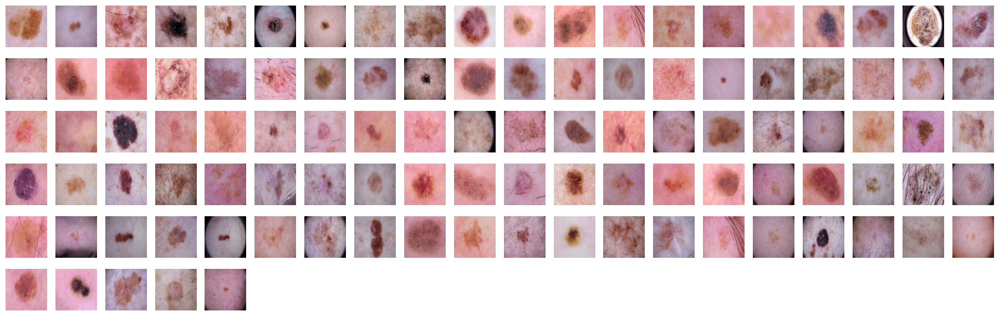

All images for class ''Melanocytic nevi'' that were misclassified in test set:


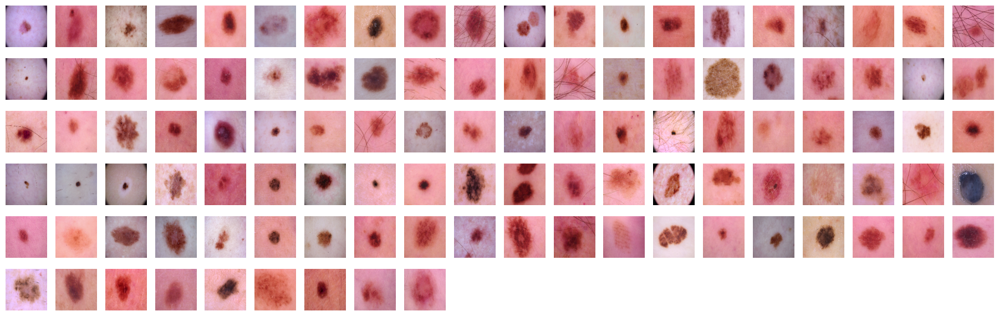

All images for class ''Melanoma'' that were misclassified in test set:


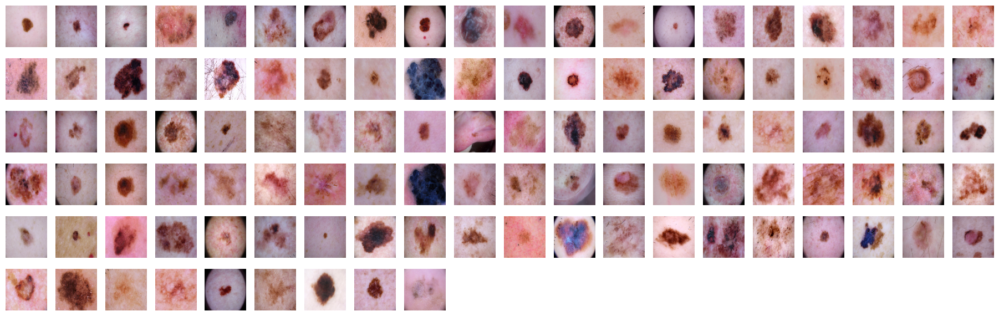

In [21]:
visualize_all_misclassified_images(misclassified_instances)

After reviewing the misclassified images for "Benign keratosis," "Melanocytic nevi," and "Melanoma," we can observe that the model's errors may be rooted in the following:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Error Category</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Benign Keratosis</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanocytic Nevi</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanoma</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Possible Causes</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Background Confusion</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">The model may be distracted by complex backgrounds, leading to misclassification.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Occlusions</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Significant parts of the lesion are hidden, causing the model to miss key features.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Scale Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">Lesion size significantly differs, affecting classification accuracy.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Lighting and Exposure Issues</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Inconsistent lighting conditions cause variations in visual appearance that confuse the model.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Color Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">The model has trouble with the wide range of colors within these lesion classes.</td>
        </tr>
        <!-- ...Other error categories would be included here as well -->
    </tbody>
</table>


Strategies for Improvement:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Improvement Strategy</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Refine Data Augmentation</td>
            <td style="border:1px solid black; padding:10px;">Include more images by using data augmentation to flip images vertically and horizontally. Also, randomly rotate the image, and shift the width and height.</td>
        </tr>
    </tbody>
</table>

<br>

## ⭐ Iteration #2 ⭐


<br>

### 2.1. Preprocessing (Iteration #2)

The code initializes image data generators for training, validation, and testing in a neural network. It includes data augmentation (flips, rotations, shifts) for the training set, while only rescaling images for validation and testing sets. All generators load and resize images from specific directories for multi-class classification.


In [71]:
# Parameters
image_height, image_width, num_channels = 224, 224, 3
batch_size = 32
rescale_ratio = 1./255

# Data generator for training set
train_datagen_2 = ImageDataGenerator(
    rescale = rescale_ratio,
    vertical_flip = True,
    horizontal_flip = True,
    rotation_range = 30,
    width_shift_range = 0.05,  
    height_shift_range = 0.05,  
    )

train_generator_2 = train_datagen_2.flow_from_directory(
    'data/processed/train/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for validation set
val_datagen_2 = ImageDataGenerator(rescale = rescale_ratio)
validation_generator_2 = val_datagen_2.flow_from_directory( 
    'data/processed/validation/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for testing set
test_datagen_2 = ImageDataGenerator(rescale = rescale_ratio)
test_generator_2 = test_datagen_2.flow_from_directory( 
    'data/processed/test/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

Found 2307 images belonging to 3 classes.
Found 663 images belonging to 3 classes.
Found 327 images belonging to 3 classes.


<br>

### 2.2. CNN Architecture (Iteration #2)

The code builds a Keras sequential neural network with two CNN layers, max pooling, batch normalization, and dropout for regularization. It includes a fully connected and a softmax output layer for three-class classification. Compiled with Adam optimizer and categorical crossentropy, it tracks accuracy and other key metrics. 

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_617 (Conv2D)         (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 111, 111, 32)     0         
 g2D)                                                            
                                                                 
 batch_normalization_613 (Ba  (None, 111, 111, 32)     128       
 tchNormalization)                                               
                                                                 
 conv2d_618 (Conv2D)         (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 54, 54, 64)       0         
 g2D)                                                            
                                                      

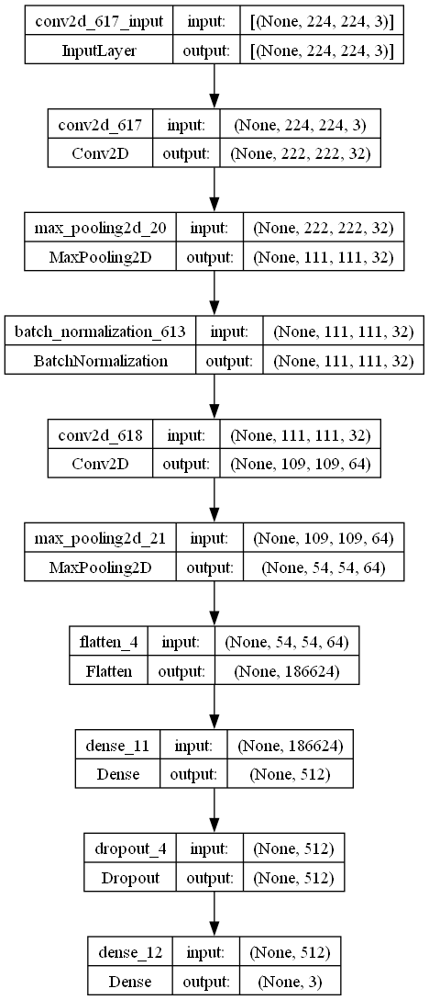

In [73]:
# Create a Sequential model
model_2 = keras.models.Sequential()

# Add layer 1 (convolutional layer + max pooling layer + batch normalization)
model_2.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(image_height, image_width, 3)))
model_2.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model_2.add(keras.layers.BatchNormalization())

# Add layer 2 (convolutional layer + max pooling layer)
model_2.add(keras.layers.Conv2D(64, (3, 3), activation='relu'))
model_2.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))

# Flatten the layer
model_2.add(keras.layers.Flatten())

# Add the first fully connected layer + dropout
model_2.add(keras.layers.Dense(512, activation='relu'))
model_2.add(keras.layers.Dropout(0.2))

# Add the output layer
model_2.add(keras.layers.Dense(3, activation='softmax'))

# Compile the model
model_2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', 'Precision', 'Recall', 'AUC'])

# Print the model summary
model_2.summary()

# Plot the model
keras.utils.plot_model(model_2, show_shapes=True)

<br>

### 2.3. CNN Training (Iteration #2)

The code trains a Keras model with callbacks for early stopping, optimal model checkpointing, and learning rate reduction on plateaus. It trains for up to 10 epochs using specified data generators, and saves the final model weights after completion.


In [74]:
# List of callbacks
callbacks = [
    keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    keras.callbacks.ModelCheckpoint("./models/best_model_iteration_2.h5", save_best_only=True),
    keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=3)
]

# Train the model
history = model_2.fit(
    train_generator_2,
    epochs=10,
    validation_data=validation_generator_2,
    callbacks=callbacks
)

# Save the last weights
model_2.save("./models/last_model_iteration_2.h5")

Epoch 1/10
73/73 [==============================] - 323s 4s/step - loss: 5.3409 - accuracy: 0.5141 - precision: 0.5266 - recall: 0.4504 - auc: 0.6631 - val_loss: 1.0892 - val_accuracy: 0.3922 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.5766 - lr: 0.0010
Epoch 2/10
73/73 [==============================] - 284s 4s/step - loss: 0.8803 - accuracy: 0.5960 - precision: 0.6901 - recall: 0.4083 - auc: 0.7835 - val_loss: 1.0985 - val_accuracy: 0.3710 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.5261 - lr: 0.0010
Epoch 3/10
73/73 [==============================] - 301s 4s/step - loss: 0.8029 - accuracy: 0.6446 - precision: 0.7150 - recall: 0.5154 - auc: 0.8224 - val_loss: 1.0701 - val_accuracy: 0.5068 - val_precision: 1.0000 - val_recall: 0.0121 - val_auc: 0.6505 - lr: 0.0010
Epoch 4/10
73/73 [==============================] - 310s 4s/step - loss: 0.7886 - accuracy: 0.6407 - precision: 0.7119 - recall: 0.4937 - auc: 0.8249 - val_loss: 1.0240 - val_accur

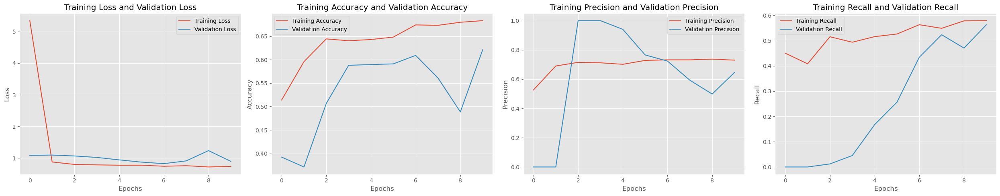

In [75]:
metrics = [
    ('loss', 'Loss'), 
    ('accuracy', 'Accuracy'), 
    ('precision', 'Precision'), 
    ('recall', 'Recall'), 
]
plt.figure(figsize=(25, 5))

for i, (metric, label) in enumerate(metrics, 1):
    plt.subplot(1, 4, i)
    plt.plot(history.history[metric], label=f'Training {label}')
    plt.plot(history.history[f'val_{metric}'], label=f'Validation {label}')
    plt.legend()
    plt.title(f'Training {label} and Validation {label}')
    plt.xlabel('Epochs')
    plt.ylabel(label)

plt.tight_layout()
plt.show()

<br>

### 2.4. Model Performance (Iteration #2)

The code loads the best-performing Keras model and evaluates it on training, validation, and test sets, visualizing metrics like loss, accuracy, precision, recall, and AUC as gauge charts. It also plots the model's training history, comparing training and validation performance across different metrics over the epochs, providing a clear visual representation of the model's performance.


In [76]:
# Load the best weights for model 1
model_2 = keras.models.load_model("./models/best_model_iteration_2.h5")

11/11 [==============================] - 9s 827ms/step


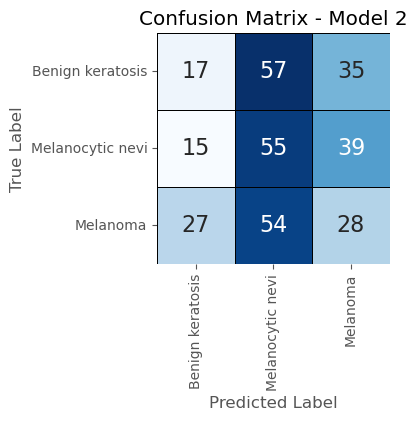

In [77]:
# Confusion matrix
y_pred = model_2.predict(test_generator_1)

# Convert predictions to binary
y_pred = np.argmax(y_pred, axis=1)

# True labels
y_true = test_generator_2.classes

# Confusion matrix
confusion_matrix_2 = confusion_matrix(y_true, y_pred)

# Visualize confusion matrix
plt.figure(figsize=(3, 3))
sns.heatmap(confusion_matrix_2, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"], yticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"])
plt.title('Confusion Matrix - Model 2')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [34]:
# List of data generators
generator_splits = ['train_generator_2', 'validation_generator_2', 'test_generator_2']

# Iterate over the generator splits
for generator in generator_splits:

    # Evaluate the model on the current generator
    loss, accuracy, precision, recall, auc = model_2.evaluate(eval(generator))

    # Plot the metrics
    plot_metrics_gauge_charts(
        metrics = ['Loss', 'Accuracy', 'Precision', 'Recall', 'AUC'], values = [loss, accuracy, precision, recall, auc], title = f"Model Metrics for {generator.split('_')[0].capitalize()} Set",
    )

73/73 [==============================] - 39s 534ms/step - loss: 0.8412 - accuracy: 0.6433 - precision: 0.7717 - recall: 0.3429 - auc: 0.8180


21/21 [==============================] - 7s 310ms/step - loss: 0.8229 - accuracy: 0.6410 - precision: 0.7695 - recall: 0.4027 - auc: 0.8214


11/11 [==============================] - 3s 305ms/step - loss: 0.8531 - accuracy: 0.6239 - precision: 0.7425 - recall: 0.3792 - auc: 0.7985


__RESULT:__ <br>

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Metric</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Training Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Validation Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Test Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Interpretation</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Loss</td>
            <td style="border:1px solid black; padding:10px;">0.8412</td>
            <td style="border:1px solid black; padding:10px;">0.8229</td>
            <td style="border:1px solid black; padding:10px;">0.8531</td>
            <td style="border:1px solid black; padding:10px;">The model shows relatively consistent loss across all datasets, suggesting stability in model performance.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Accuracy</td>
            <td style="border:1px solid black; padding:10px;">64.33%</td>
            <td style="border:1px solid black; padding:10px;">64.10%</td>
            <td style="border:1px solid black; padding:10px;">62.39%</td>
            <td style="border:1px solid black; padding:10px;">Accuracy is fairly consistent across datasets, indicating good generalizability of the model.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Precision</td>
            <td style="border:1px solid black; padding:10px;">77.17%</td>
            <td style="border:1px solid black; padding:10px;">76.95%</td>
            <td style="border:1px solid black; padding:10px;">74.25%</td>
            <td style="border:1px solid black; padding:10px;">Precision is relatively high, but a slight decrease in the test set suggests a marginally reduced ability to predict true positives.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Recall</td>
            <td style="border:1px solid black; padding:10px;">34.29%</td>
            <td style="border:1px solid black; padding:10px;">40.27%</td>
            <td style="border:1px solid black; padding:10px;">37.92%</td>
            <td style="border:1px solid black; padding:10px;">Recall varies across the datasets, indicating variability in the model's ability to correctly identify all actual positives.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">AUC</td>
            <td style="border:1px solid black; padding:10px;">81.80%</td>
            <td style="border:1px solid black; padding:10px;">82.14%</td>
            <td style="border:1px solid black; padding:10px;">79.85%</td>
            <td style="border:1px solid black; padding:10px;">The AUC score is high across all datasets, suggesting a good overall classification performance of the model.</td>
        </tr>
    </tbody>
</table>

__BASELINE COMPARISON:__

Upon comparing the accuracy of model_1 with the baseline, it is observed that there has been an improvement from $48.92\%$ to $62.39\%$.

<br>

### 2.5. Error Analysis (Iteration #2)

The code is for error analysis in a machine learning model. It loads a pre-trained model, identifies misclassified images in a test set, visualizes error distributions, and displays the misclassified images for further examination.

In [35]:
# Load the best model
model_2 = load_model('./models/best_model_iteration_2.h5')

In [ ]:
# Function for getting the misclassified instances
def get_misclassified_instances(model, metadata):

    # Test set info from metadata
    test_set_df = metadata[metadata["split"] == "test"]

    # Loop over the metadata
    for i_index, i_row in tqdm(test_set_df.iterrows(), total=test_set_df.shape[0], colour="green", ncols=100):

        # Image
        img = keras.preprocessing.image.load_img(i_row["image path"], target_size=(224, 224))   # Load the image
        img = keras.preprocessing.image.img_to_array(img)                                       # Convert to numpy array
        img = img / 255.0                                                                       # Normalize the image
        img = np.expand_dims(img, axis=0)                                                       # Convert to batch

        # Predict the image
        pred = model.predict(img, verbose=0)

        # Predicted class int and name
        pred_class = np.argmax(pred)
        pred_class_name = test_set_df["lesion_type"].unique()[pred_class]

        # Add the predicted class to the metadata
        test_set_df.at[i_index, 'predicted class'] = int(pred_class)
        test_set_df.at[i_index, 'predicted class name'] = pred_class_name

    # Get the misclassified instances
    metadata_misclassified = test_set_df[test_set_df["label"] != test_set_df["predicted class"]]

    return metadata_misclassified

In [37]:
# Get the misclassified instances in test set
misclassified_instances = get_misclassified_instances(model_2, metadata)

misclassified_instances

100%|█████████████████████████████████████████████████████████████| 327/327 [00:29<00:00, 11.24it/s]


,lesion_id,image_id,dx,dx_type,age,sex,localization,label,lesion_type,image path,split,predicted class,predicted class name
29,HAM_0003206,ISIC_0032365,bkl,histo,60.0,female,lower extremity,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
75,HAM_0006670,ISIC_0027335,bkl,histo,75.0,male,back,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
100,HAM_0005463,ISIC_0032315,bkl,consensus,45.0,male,back,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
111,HAM_0007427,ISIC_0033491,bkl,consensus,60.0,female,back,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
155,HAM_0000607,ISIC_0025431,bkl,consensus,45.0,female,abdomen,2,Benign keratosis,./data/processed/test/Benign keratosis/ISIC_00...,test,0.0,Benign keratosis
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3236,HAM_0003386,ISIC_0032662,mel,histo,70.0,male,abdomen,4,Melanoma,./data/processed/test/Melanoma/ISIC_0032662.jpg,test,2.0,Melanoma
3245,HAM_0004047,ISIC_0030277,mel,histo,55.0,female,upper extremity,4,Melanoma,./data/processed/test/Melanoma/ISIC_0030277.jpg,test,2.0,Melanoma
3251,HAM_0006376,ISIC_0033662,mel,histo,70.0,female,lower extremity,4,Melanoma,./data/processed/test/Melanoma/ISIC_0033662.jpg,test,0.0,Benign keratosis
3260,HAM_0004813,ISIC_0027063,mel,histo,80.0,male,abdomen,4,Melanoma,./data/processed/test/Melanoma/ISIC_0027063.jpg,test,2.0,Melanoma


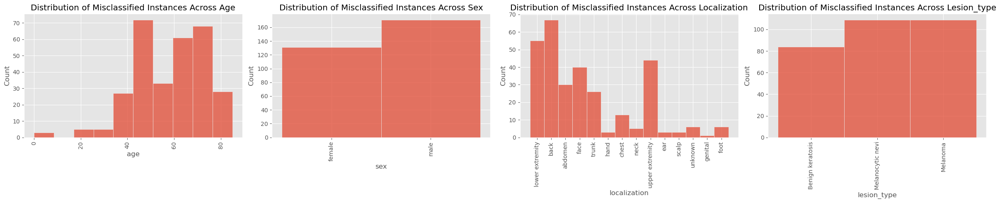

In [38]:
### Frequency of errors in different features

# Create a single row of 4 subplots, with a total figure size of 24x5 inches
fig, axs = plt.subplots(1, 4, figsize=(24, 5))

# Loop over the list of categories
for i, category in enumerate(['age', 'sex', 'localization', 'lesion_type']):
    
    # Select the subplot to plot on
    ax = axs[i]
    
    # Create a histogram of the current category, using the misclassified instances data
    sns.histplot(data=misclassified_instances, x=category, bins=10, ax=ax)
    
    # Set the title of the subplot
    ax.set_title(f'Distribution of Misclassified Instances Across {category.capitalize()}')
    
    # Rotate the x-axis labels by 90 degrees
    ax.tick_params(axis='x', rotation=90)

# Adjust the layout so that the subplots do not overlap
plt.tight_layout()

# Display the figure
plt.show()

In [39]:
# Function for visualizing all misclassified images
def visualize_all_misclassified_images(misclassified_instances):

    # List of unique labels
    classes = misclassified_instances['lesion_type'].unique()

    # Loop over the classes
    for class_label in classes:

        # Report
        print(f"All images for class ''{class_label}'' that were misclassified in test set:")

        # Filter the misclassified instances by class
        metadata_class = misclassified_instances[misclassified_instances['lesion_type'] == class_label]

        # Determine the number of rows needed
        rows = math.ceil(len(metadata_class) / 20)

        # Create a new figure
        plt.figure(figsize=(23, 1.2 * rows))

        # Loop over the misclassified instances of this class
        for i_index, i_row in enumerate(metadata_class.iterrows()):

            # Load the image
            img = keras.preprocessing.image.load_img(i_row[1]["image path"], target_size=(128, 128))
            img = keras.preprocessing.image.img_to_array(img)
            img = img / 255.0

            # Create a subplot for this image
            plt.subplot(rows, 20, i_index + 1)
            plt.imshow(img)
            plt.axis('off')

        plt.show()

All images for class ''Benign keratosis'' that were misclassified in test set:


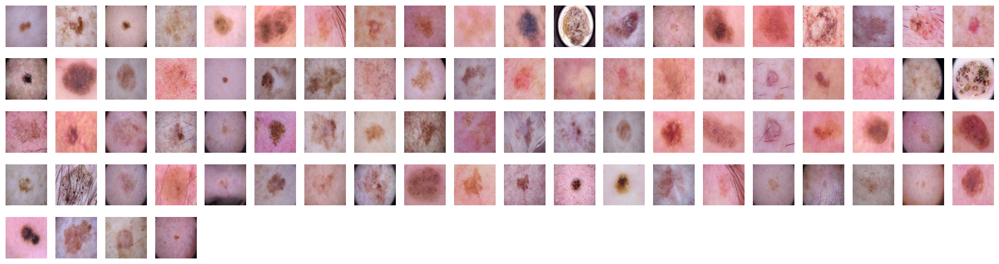

All images for class ''Melanocytic nevi'' that were misclassified in test set:


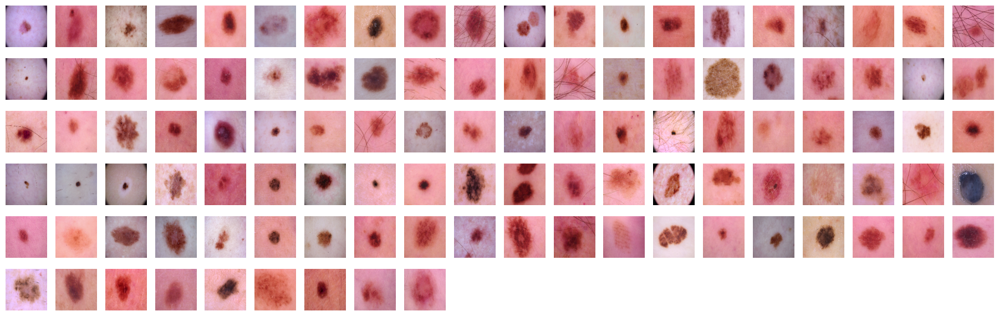

All images for class ''Melanoma'' that were misclassified in test set:


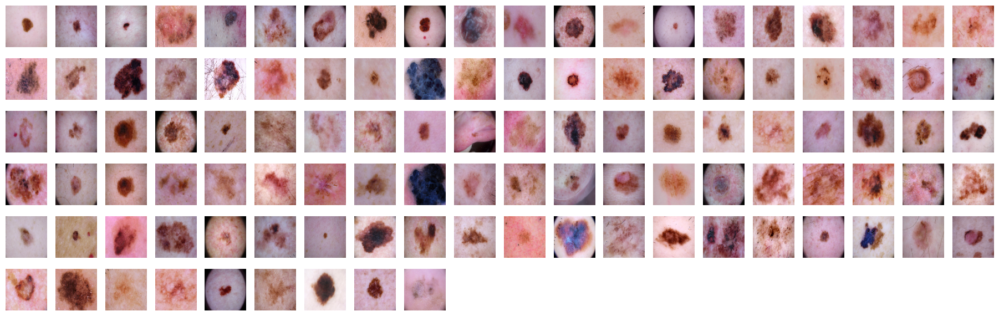

In [40]:
visualize_all_misclassified_images(misclassified_instances)

After reviewing the misclassified images for "Benign keratosis," "Melanocytic nevi," and "Melanoma," we can observe that the model's errors may be rooted in the following:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Error Category</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Benign Keratosis</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanocytic Nevi</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanoma</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Possible Causes</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Background Confusion</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Misclassification due to complex or textured backgrounds that overshadow the lesion.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Occlusions</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Key features of the lesions were obscured by hair or other objects.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Scale Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">Lesions too small or large compared to the average size seen in training data.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Lighting and Exposure Issues</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Variations in lighting conditions caused changes in lesion appearance.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Color Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Unusual colors not well represented in the training data leading to errors.</td>
        </tr>
        <!-- Other categories would follow in the same fashion, with 'X' marking the categories where issues were identified and 'Possible Causes' detailing the hypothesized reasons for misclassification. -->
    </tbody>
</table>



Strategy for Improvement:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Improvement Strategy</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Refine Model (Transfer Learning)</td>
            <td style="border:1px solid black; padding:10px;">Refine the model by using a deeper model that can learn better than a simple one. We will use the Inception ResNet Model.</td>
        </tr>
    </tbody>
</table>

<br>

## ⭐ Iteration #3 ⭐


<br>

### 3.1. Preprocessing (Iteration #3)

The code creates image data generators for training, validation, and testing sets in a neural network without using any data augmentation methods. It sets specific image dimensions and batch size, rescales images, and loads them from designated directories for multi-class classification.

In [41]:
# Parameters
image_height, image_width, num_channels = 224, 224, 3
batch_size = 32
rescale_ratio = 1./255

# Data generator for training set
train_datagen_3 = ImageDataGenerator(rescale = rescale_ratio)
train_generator_3 = train_datagen_3.flow_from_directory(
    'data/processed/train/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for validation set
val_datagen_3 = ImageDataGenerator(rescale = rescale_ratio)
validation_generator_3 = val_datagen_3.flow_from_directory( 
    'data/processed/validation/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for testing set
test_datagen_3 = ImageDataGenerator(rescale = rescale_ratio)
test_generator_3 = test_datagen_3.flow_from_directory( 
    'data/processed/test/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

Found 2307 images belonging to 3 classes.
Found 663 images belonging to 3 classes.
Found 327 images belonging to 3 classes.


<br>

### 3.2. CNN Architecture (Iteration #3)

This code creates a Keras model using the InceptionResNetV2 architecture with a Global Average Pooling layer and a softmax output layer for three-class classification. It's compiled with Adam optimizer and categorical crossentropy loss, tracking key performance metrics. 

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_resnet_v2 (Functi  (None, 5, 5, 1536)       54336736  
 onal)                                                           
                                                                 
 global_average_pooling2d_1   (None, 1536)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_7 (Dense)             (None, 3)                 4611      
                                                                 
Total params: 54,341,347
Trainable params: 54,280,803
Non-trainable params: 60,544
_________________________________________________________________


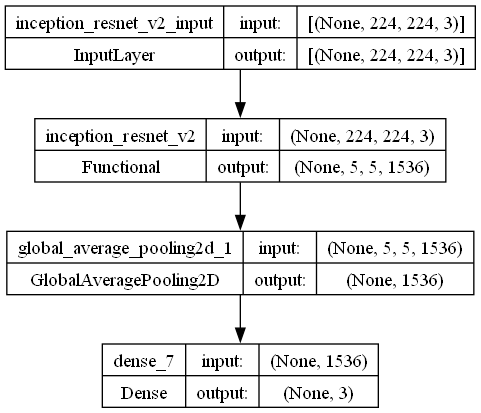

In [43]:
### InceptionResNetV2 architecture

# Create a Sequential model
model_3 = keras.models.Sequential()

# Add the InceptionV3 model
model_3.add(keras.applications.InceptionResNetV2(include_top=False, weights=None, input_shape=(image_height, image_width, 3)))

# Add the Global Average Pooling layer
model_3.add(keras.layers.GlobalAveragePooling2D())

# Add the output layer
model_3.add(keras.layers.Dense(3, activation='softmax'))

# Compile the model
model_3.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', 'Precision', 'Recall', 'AUC'])

# Print the model summary
model_3.summary()

# Plot the model
keras.utils.plot_model(model_3, show_shapes=True)

<br>

### 3.3. CNN Training (Iteration #3)

The code trains a Keras model with callbacks for early stopping, optimal model checkpointing, and learning rate reduction on plateaus. It trains for up to 10 epochs using specified data generators, and saves the final model weights after completion.


In [45]:
# List of callbacks
callbacks = [
    keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    keras.callbacks.ModelCheckpoint("./models/best_model_iteration_3.h5", save_best_only=True),
    keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=3)
]

# Train the model
history = model_3.fit(
    train_generator_3,
    epochs=10,
    validation_data=validation_generator_3,
    callbacks=callbacks
)

# Save the last weights
model_3.save("./models/last_model_iteration_3.h5")

Epoch 1/10
73/73 [==============================] - 585s 8s/step - loss: 0.9661 - accuracy: 0.6021 - precision: 0.6539 - recall: 0.4954 - auc: 0.7725 - val_loss: 1.2912 - val_accuracy: 0.3484 - val_precision: 0.5188 - val_recall: 0.2293 - val_auc: 0.5592 - lr: 0.0010
Epoch 2/10
73/73 [==============================] - 574s 8s/step - loss: 0.8519 - accuracy: 0.6433 - precision: 0.6952 - recall: 0.5665 - auc: 0.8113 - val_loss: 1.5426 - val_accuracy: 0.3333 - val_precision: 0.3359 - val_recall: 0.3333 - val_auc: 0.5325 - lr: 0.0010
Epoch 3/10
73/73 [==============================] - 556s 8s/step - loss: 0.8070 - accuracy: 0.6558 - precision: 0.7065 - recall: 0.5644 - auc: 0.8244 - val_loss: 1.8287 - val_accuracy: 0.3333 - val_precision: 0.3333 - val_recall: 0.3333 - val_auc: 0.5521 - lr: 0.0010
Epoch 4/10
73/73 [==============================] - 563s 8s/step - loss: 0.8112 - accuracy: 0.6493 - precision: 0.6953 - recall: 0.5618 - auc: 0.8197 - val_loss: 1.4142 - val_accuracy: 0.3348 - va

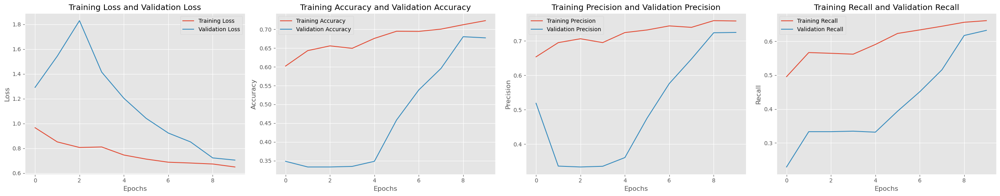

In [47]:
metrics = [
    ('loss', 'Loss'), 
    ('accuracy', 'Accuracy'), 
    ('precision', 'Precision'), 
    ('recall', 'Recall'), 
]
plt.figure(figsize=(25, 5))

for i, (metric, label) in enumerate(metrics, 1):
    plt.subplot(1, 4, i)
    plt.plot(history.history[metric], label=f'Training {label}')
    plt.plot(history.history[f'val_{metric}'], label=f'Validation {label}')
    plt.legend()
    plt.title(f'Training {label} and Validation {label}')
    plt.xlabel('Epochs')
    plt.ylabel(label)

plt.tight_layout()
plt.show()

<br>

### 3.4. Model Performance (Iteration #3)

The code loads the best-performing Keras model and evaluates it on training, validation, and test sets, visualizing metrics like loss, accuracy, precision, recall, and AUC as gauge charts. It also plots the model's training history, comparing training and validation performance across different metrics over the epochs, providing a clear visual representation of the model's performance.


In [48]:
# Load the best weights for model 1
model_3 = keras.models.load_model("./models/best_model_iteration_3.h5")

11/11 [==============================] - 30s 3s/step


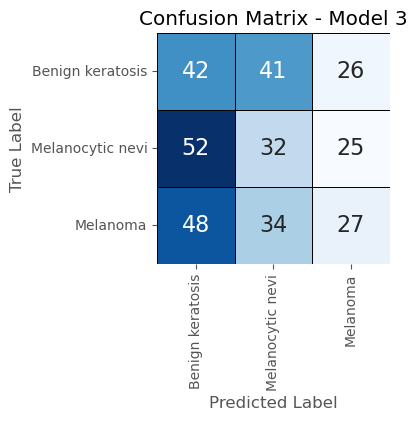

In [49]:
# Confusion matrix
y_pred = model_3.predict(test_generator_3)

# Convert predictions to binary
y_pred = np.argmax(y_pred, axis=1)

# True labels
y_true = test_generator_3.classes

# Confusion matrix
confusion_matrix_3 = confusion_matrix(y_true, y_pred)

# Visualize confusion matrix
plt.figure(figsize=(3, 3))
sns.heatmap(confusion_matrix_3, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"], yticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"])
plt.title('Confusion Matrix - Model 3')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [50]:
# List of data generators
generator_splits = ['train_generator_3', 'validation_generator_3', 'test_generator_3']

# Iterate over the generator splits
for generator in generator_splits:

    # Evaluate the model on the current generator
    loss, accuracy, precision, recall, auc = model_3.evaluate(eval(generator))

    # Plot the metrics
    plot_metrics_gauge_charts(
        metrics = ['Loss', 'Accuracy', 'Precision', 'Recall', 'AUC'], values = [loss, accuracy, precision, recall, auc], title = f"Model Metrics for {generator.split('_')[0].capitalize()} Set",
    )

73/73 [==============================] - 206s 3s/step - loss: 0.6520 - accuracy: 0.7161 - precision: 0.7568 - recall: 0.6528 - auc: 0.8846


21/21 [==============================] - 58s 3s/step - loss: 0.7053 - accuracy: 0.6772 - precision: 0.7249 - recall: 0.6320 - auc: 0.8636


11/11 [==============================] - 29s 3s/step - loss: 0.6727 - accuracy: 0.7217 - precision: 0.7589 - recall: 0.6544 - auc: 0.8774


__RESULT:__ <br>

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Metric</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Training Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Validation Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Test Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Interpretation</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Loss</td>
            <td style="border:1px solid black; padding:10px;">0.6520</td>
            <td style="border:1px solid black; padding:10px;">0.7053</td>
            <td style="border:1px solid black; padding:10px;">0.6727</td>
            <td style="border:1px solid black; padding:10px;">Indicates the error of the model. Lower values are better.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Accuracy</td>
            <td style="border:1px solid black; padding:10px;">71.61%</td>
            <td style="border:1px solid black; padding:10px;">67.72%</td>
            <td style="border:1px solid black; padding:10px;">72.17%</td>
            <td style="border:1px solid black; padding:10px;">Reflects the proportion of true results (both true positives and true negatives) among the total cases.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Precision</td>
            <td style="border:1px solid black; padding:10px;">75.68%</td>
            <td style="border:1px solid black; padding:10px;">72.49%</td>
            <td style="border:1px solid black; padding:10px;">75.89%</td>
            <td style="border:1px solid black; padding:10px;">Indicates the proportion of positive identifications that were actually correct.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Recall</td>
            <td style="border:1px solid black; padding:10px;">65.28%</td>
            <td style="border:1px solid black; padding:10px;">63.20%</td>
            <td style="border:1px solid black; padding:10px;">65.44%</td>
            <td style="border:1px solid black; padding:10px;">Reflects the proportion of actual positives that were correctly identified.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">AUC</td>
            <td style="border:1px solid black; padding:10px;">88.46%</td>
            <td style="border:1px solid black; padding:10px;">86.36%</td>
            <td style="border:1px solid black; padding:10px;">87.74%</td>
            <td style="border:1px solid black; padding:10px;">Represents the measure of the ability of a classifier to distinguish between classes.</td>
        </tr>
    </tbody>
</table>


__BASELINE COMPARISON:__

Upon comparing the accuracy of model_1 with the baseline, it is observed that there has been an improvement from $48.92\%$ to $72.2\%$.

<br>

### 3.5. Error Analysis (Iteration #3)

The code is for error analysis in a machine learning model. It loads a pre-trained model, identifies misclassified images in a test set, visualizes error distributions, and displays the misclassified images for further examination.








In [51]:
# Load the best model
model_3 = load_model('./models/best_model_iteration_3.h5')

In [52]:
# Function for getting the misclassified instances
def get_misclassified_instances(model, metadata):

    # Test set info from metadata
    test_set_df = metadata[metadata["split"] == "test"]

    # Loop over the metadata
    for i_index, i_row in tqdm(test_set_df.iterrows(), total=test_set_df.shape[0], colour="green", ncols=100):

        # Image
        img = keras.preprocessing.image.load_img(i_row["image path"], target_size=(224, 224))   # Load the image
        img = keras.preprocessing.image.img_to_array(img)                                       # Convert to numpy array
        img = img / 255.0                                                                       # Normalize the image
        img = np.expand_dims(img, axis=0)                                                       # Convert to batch

        # Predict the image
        pred = model.predict(img, verbose=0)

        # Predicted class int and name
        pred_class = np.argmax(pred)
        pred_class_name = test_set_df["lesion_type"].unique()[pred_class]

        # Add the predicted class to the metadata
        test_set_df.at[i_index, 'predicted class'] = int(pred_class)
        test_set_df.at[i_index, 'predicted class name'] = pred_class_name

    # Get the misclassified instances
    metadata_misclassified = test_set_df[test_set_df["label"] != test_set_df["predicted class"]]

    return metadata_misclassified

In [53]:
# Get the misclassified instances in test set
misclassified_instances = get_misclassified_instances(model_3, metadata)

100%|█████████████████████████████████████████████████████████████| 327/327 [04:04<00:00,  1.34it/s]


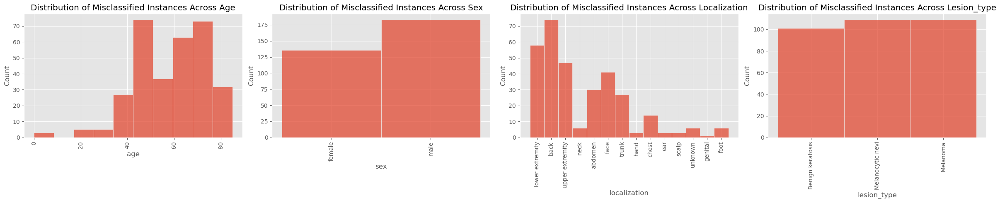

In [54]:
### Frequency of errors in different features

# Create a single row of 4 subplots, with a total figure size of 24x5 inches
fig, axs = plt.subplots(1, 4, figsize=(24, 5))

# Loop over the list of categories
for i, category in enumerate(['age', 'sex', 'localization', 'lesion_type']):
    
    # Select the subplot to plot on
    ax = axs[i]
    
    # Create a histogram of the current category, using the misclassified instances data
    sns.histplot(data=misclassified_instances, x=category, bins=10, ax=ax)
    
    # Set the title of the subplot
    ax.set_title(f'Distribution of Misclassified Instances Across {category.capitalize()}')
    
    # Rotate the x-axis labels by 90 degrees
    ax.tick_params(axis='x', rotation=90)

# Adjust the layout so that the subplots do not overlap
plt.tight_layout()

# Display the figure
plt.show()

In [55]:
# Function for visualizing all misclassified images
def visualize_all_misclassified_images(misclassified_instances):

    # List of unique labels
    classes = misclassified_instances['lesion_type'].unique()

    # Loop over the classes
    for class_label in classes:

        # Report
        print(f"All images for class ''{class_label}'' that were misclassified in test set:")

        # Filter the misclassified instances by class
        metadata_class = misclassified_instances[misclassified_instances['lesion_type'] == class_label]

        # Determine the number of rows needed
        rows = math.ceil(len(metadata_class) / 20)

        # Create a new figure
        plt.figure(figsize=(23, 1.2 * rows))

        # Loop over the misclassified instances of this class
        for i_index, i_row in enumerate(metadata_class.iterrows()):

            # Load the image
            img = keras.preprocessing.image.load_img(i_row[1]["image path"], target_size=(128, 128))
            img = keras.preprocessing.image.img_to_array(img)
            img = img / 255.0

            # Create a subplot for this image
            plt.subplot(rows, 20, i_index + 1)
            plt.imshow(img)
            plt.axis('off')

        plt.show()

All images for class ''Benign keratosis'' that were misclassified in test set:


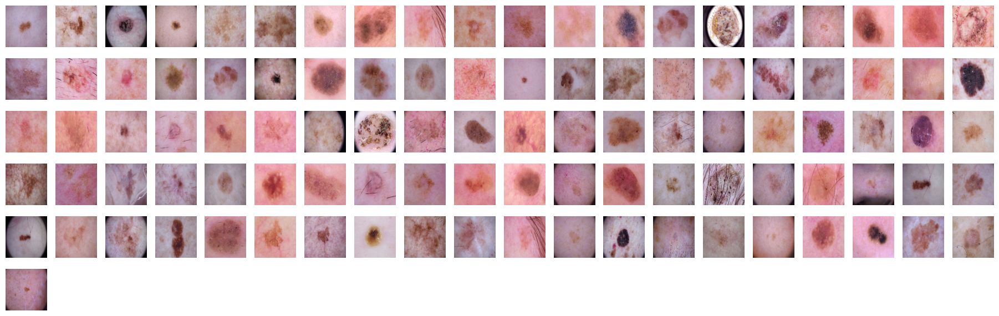

All images for class ''Melanocytic nevi'' that were misclassified in test set:


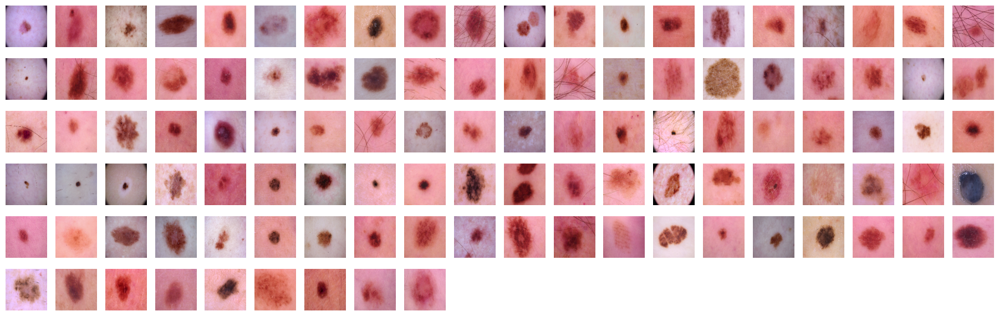

All images for class ''Melanoma'' that were misclassified in test set:


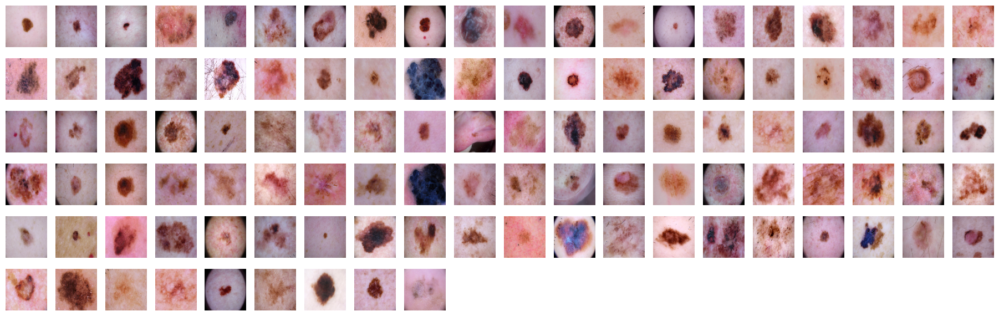

In [56]:
visualize_all_misclassified_images(misclassified_instances)

After reviewing the misclassified images for "Benign keratosis," "Melanocytic nevi," and "Melanoma," we can observe that the model's errors may be rooted in the following:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Error Category</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Benign Keratosis</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanocytic Nevi</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanoma</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Possible Causes</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Background Confusion</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">The model continues to misclassify based on complex backgrounds rather than the lesions themselves.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Occlusions</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Lesions are still being obscured by other objects, causing the model to fail in recognizing them.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Scale Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">Misclassifications are occurring when the lesions appear at a different scale than in the training set.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Lighting and Exposure Issues</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Inconsistent lighting conditions are affecting the model's ability to accurately classify the lesions.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Color Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">The model is challenged by the wide range of colors and may be overfitting to specific hues.</td>
        </tr>
        <!-- ...Other error categories could be added here -->
    </tbody>
</table>

Strategies for Improvement:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Improvement Strategy</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Combine Transfer Learning with Data Augmentation</td>
            <td style="border:1px solid black; padding:10px;">
            For the next iteration, combine the previous two improvements by using both data augmentation and transfer learning with the Inception-ResNet model.
            </td>
        </tr>
    </tbody>
</table>

<br>

## ⭐ Iteration #4 ⭐


<br>

### 4.1. Preprocessing (Iteration #4)

The code initializes image data generators for training, validation, and testing in a neural network. It includes data augmentation (flips, rotations, shifts) for the training set, while only rescaling images for validation and testing sets. All generators load and resize images from specific directories for multi-class classification.

In [57]:
# Parameters
image_height, image_width, num_channels = 224, 224, 3
batch_size = 32
rescale_ratio = 1./255

# Data generator for training set
train_datagen_4 = ImageDataGenerator(
    rescale = rescale_ratio,
    vertical_flip = True,
    horizontal_flip = True,
    rotation_range = 30,
    width_shift_range = 0.05,  
    height_shift_range = 0.05,  
    )

train_generator_4 = train_datagen_4.flow_from_directory(
    'data/processed/train/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for validation set
val_datagen_4 = ImageDataGenerator(rescale = rescale_ratio)
validation_generator_4 = val_datagen_4.flow_from_directory( 
    'data/processed/validation/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

# Data generator for testing set
test_datagen_4 = ImageDataGenerator(rescale = rescale_ratio)
test_generator_4 = test_datagen_4.flow_from_directory( 
    'data/processed/test/', target_size=(image_height, image_width), batch_size=batch_size, class_mode='categorical'
)

Found 2307 images belonging to 3 classes.
Found 663 images belonging to 3 classes.
Found 327 images belonging to 3 classes.


<br>

### 4.2. CNN Architecture (Iteration #4)

This code creates a Keras model using the InceptionResNetV2 architecture with a Global Average Pooling layer and a softmax output layer for three-class classification. It's compiled with Adam optimizer and categorical crossentropy loss, tracking key performance metrics. 

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_resnet_v2 (Functi  (None, 5, 5, 1536)       54336736  
 onal)                                                           
                                                                 
 global_average_pooling2d_2   (None, 1536)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_8 (Dense)             (None, 3)                 4611      
                                                                 
Total params: 54,341,347
Trainable params: 54,280,803
Non-trainable params: 60,544
_________________________________________________________________


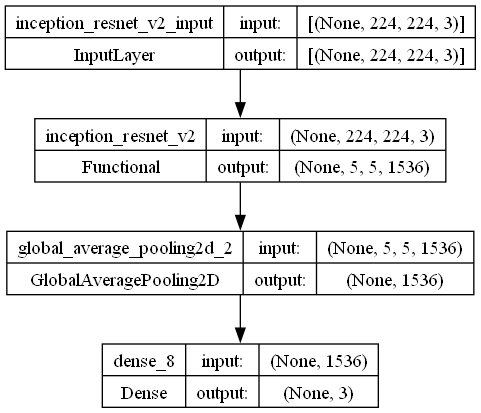

In [58]:
### InceptionResNetV2 architecture

# Create a Sequential model
model_4 = keras.models.Sequential()

# Add the InceptionV3 model
model_4.add(keras.applications.InceptionResNetV2(include_top=False, weights=None, input_shape=(image_height, image_width, 3)))

# Add the Global Average Pooling layer
model_4.add(keras.layers.GlobalAveragePooling2D())

# Add the output layer
model_4.add(keras.layers.Dense(3, activation='softmax'))

# Compile the model
model_4.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', 'Precision', 'Recall', 'AUC'])

# Print the model summary
model_4.summary()

# Plot the model
keras.utils.plot_model(model_4, show_shapes=True)

<br>

### 4.3. CNN Training  (Iteration #4)

The code trains a Keras model with callbacks for early stopping, optimal model checkpointing, and learning rate reduction on plateaus. It trains for up to 10 epochs using specified data generators, and saves the final model weights after completion.


In [59]:
# List of callbacks
callbacks = [
    keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    keras.callbacks.ModelCheckpoint("./models/best_model_iteration_4.h5", save_best_only=True),
    keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=3)
]

# Train the model
history = model_4.fit(
    train_generator_4,
    epochs=10,
    validation_data=validation_generator_4,
    callbacks=callbacks
)

# Save the last weights
model_4.save("./models/last_model_iteration_4.h5")

Epoch 1/10
73/73 [==============================] - 1498s 20s/step - loss: 0.9915 - accuracy: 0.6099 - precision: 0.6549 - recall: 0.5150 - auc: 0.7828 - val_loss: 2.2287 - val_accuracy: 0.3333 - val_precision: 0.3333 - val_recall: 0.3333 - val_auc: 0.5313 - lr: 0.0010
Epoch 2/10
73/73 [==============================] - 1375s 19s/step - loss: 0.8251 - accuracy: 0.6376 - precision: 0.6912 - recall: 0.5336 - auc: 0.8142 - val_loss: 1.6645 - val_accuracy: 0.3273 - val_precision: 0.3291 - val_recall: 0.3092 - val_auc: 0.5080 - lr: 0.0010
Epoch 3/10
73/73 [==============================] - 1263s 17s/step - loss: 0.7863 - accuracy: 0.6606 - precision: 0.7052 - recall: 0.5817 - auc: 0.8307 - val_loss: 1.7777 - val_accuracy: 0.3982 - val_precision: 0.4019 - val_recall: 0.3771 - val_auc: 0.5666 - lr: 0.0010
Epoch 4/10
73/73 [==============================] - 1252s 17s/step - loss: 0.7487 - accuracy: 0.6727 - precision: 0.7225 - recall: 0.6016 - auc: 0.8463 - val_loss: 2.3174 - val_accuracy: 0.3

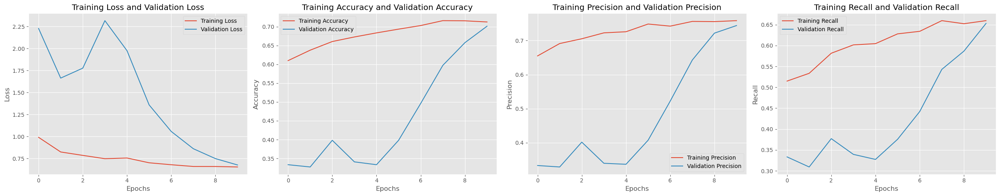

In [60]:
metrics = [
    ('loss', 'Loss'), 
    ('accuracy', 'Accuracy'), 
    ('precision', 'Precision'), 
    ('recall', 'Recall'), 
]
plt.figure(figsize=(25, 5))

for i, (metric, label) in enumerate(metrics, 1):
    plt.subplot(1, 4, i)
    plt.plot(history.history[metric], label=f'Training {label}')
    plt.plot(history.history[f'val_{metric}'], label=f'Validation {label}')
    plt.legend()
    plt.title(f'Training {label} and Validation {label}')
    plt.xlabel('Epochs')
    plt.ylabel(label)

plt.tight_layout()
plt.show()

<br>

### 4.4. Model Performance (Iteration #4)

The code loads the best-performing Keras model and evaluates it on training, validation, and test sets, visualizing metrics like loss, accuracy, precision, recall, and AUC as gauge charts. It also plots the model's training history, comparing training and validation performance across different metrics over the epochs, providing a clear visual representation of the model's performance.


In [61]:
# Load the best weights for model 1
model_4 = keras.models.load_model("./models/best_model_iteration_4.h5")

11/11 [==============================] - 49s 4s/step


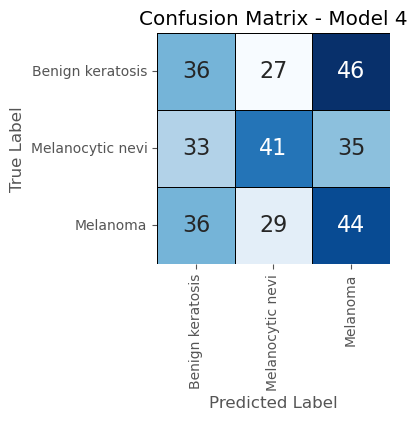

In [62]:
# Confusion matrix
y_pred = model_4.predict(test_generator_4)

# Convert predictions to binary
y_pred = np.argmax(y_pred, axis=1)

# True labels
y_true = test_generator_4.classes

# Confusion matrix
confusion_matrix_4 = confusion_matrix(y_true, y_pred)

# Visualize confusion matrix
plt.figure(figsize=(3, 3))
sns.heatmap(confusion_matrix_4, annot=True, cmap='Blues', fmt='g', cbar=False, annot_kws={"size": 16}, linewidths=0.7, linecolor='black', xticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"], yticklabels=["Benign keratosis", "Melanocytic nevi", "Melanoma"])
plt.title('Confusion Matrix - Model 4')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [63]:
# List of data generators
generator_splits = ['train_generator_4', 'validation_generator_4', 'test_generator_4']

# Iterate over the generator splits
for generator in generator_splits:

    # Evaluate the model on the current generator
    loss, accuracy, precision, recall, auc = model_4.evaluate(eval(generator))

    # Plot the metrics
    plot_metrics_gauge_charts(
        metrics = ['Loss', 'Accuracy', 'Precision', 'Recall', 'AUC'], values = [loss, accuracy, precision, recall, auc], title = f"Model Metrics for {generator.split('_')[0].capitalize()} Set",
    )

73/73 [==============================] - 338s 5s/step - loss: 0.6454 - accuracy: 0.7282 - precision: 0.7772 - recall: 0.6532 - auc: 0.8877


21/21 [==============================] - 92s 4s/step - loss: 0.6773 - accuracy: 0.7014 - precision: 0.7440 - recall: 0.6531 - auc: 0.8744


11/11 [==============================] - 46s 4s/step - loss: 0.6552 - accuracy: 0.7064 - precision: 0.7782 - recall: 0.6330 - auc: 0.8835


__RESULT:__ <br>

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Metric</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Training Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Validation Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Test Set</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Interpretation</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Loss</td>
            <td style="border:1px solid black; padding:10px;">0.6454</td>
            <td style="border:1px solid black; padding:10px;">0.6773</td>
            <td style="border:1px solid black; padding:10px;">0.6552</td>
            <td style="border:1px solid black; padding:10px;">Slight fluctuations in loss indicate variability in the model's performance across different datasets.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Accuracy</td>
            <td style="border:1px solid black; padding:10px;">72.82%</td>
            <td style="border:1px solid black; padding:10px;">70.14%</td>
            <td style="border:1px solid black; padding:10px;">70.64%</td>
            <td style="border:1px solid black; padding:10px;">Consistent accuracy across the sets indicates reliable performance, but there is room for improvement.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Precision</td>
            <td style="border:1px solid black; padding:10px;">77.72%</td>
            <td style="border:1px solid black; padding:10px;">74.40%</td>
            <td style="border:1px solid black; padding:10px;">77.82%</td>
            <td style="border:1px solid black; padding:10px;">High precision suggests good predictive quality, particularly in identifying true positives.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Recall</td>
            <td style="border:1px solid black; padding:10px;">65.32%</td>
            <td style="border:1px solid black; padding:10px;">65.31%</td>
            <td style="border:1px solid black; padding:10px;">63.30%</td>
            <td style="border:1px solid black; padding:10px;">Stable recall across datasets, with a minor decrease in the test set, suggests effectiveness in identifying relevant instances.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">AUC</td>
            <td style="border:1px solid black; padding:10px;">88.77%</td>
            <td style="border:1px solid black; padding:10px;">87.44%</td>
            <td style="border:1px solid black; padding:10px;">88.35%</td>
            <td style="border:1px solid black; padding:10px;">The high AUC scores across the sets indicate excellent model performance in distinguishing classes.</td>
        </tr>
    </tbody>
</table>


__BASELINE COMPARISON:__

Upon comparing the accuracy of model_1 with the baseline, it is observed that there has been an improvement from $48.92\%$ to $70.64\%$.

<br>

### 4.5. Error Analysis (Iteration #4)

The code is for error analysis in a machine learning model. It loads a pre-trained model, identifies misclassified images in a test set, visualizes error distributions, and displays the misclassified images for further examination.



In [64]:
# Load the best model
model_4 = load_model('./models/best_model_iteration_4.h5')

In [65]:
# Function for getting the misclassified instances
def get_misclassified_instances(model, metadata):

    # Test set info from metadata
    test_set_df = metadata[metadata["split"] == "test"]

    # Loop over the metadata
    for i_index, i_row in tqdm(test_set_df.iterrows(), total=test_set_df.shape[0], colour="green", ncols=100):

        # Image
        img = keras.preprocessing.image.load_img(i_row["image path"], target_size=(224, 224))   # Load the image
        img = keras.preprocessing.image.img_to_array(img)                                       # Convert to numpy array
        img = img / 255.0                                                                       # Normalize the image
        img = np.expand_dims(img, axis=0)                                                       # Convert to batch

        # Predict the image
        pred = model.predict(img, verbose=0)

        # Predicted class int and name
        pred_class = np.argmax(pred)
        pred_class_name = test_set_df["lesion_type"].unique()[pred_class]

        # Add the predicted class to the metadata
        test_set_df.at[i_index, 'predicted class'] = int(pred_class)
        test_set_df.at[i_index, 'predicted class name'] = pred_class_name

    # Get the misclassified instances
    metadata_misclassified = test_set_df[test_set_df["label"] != test_set_df["predicted class"]]

    return metadata_misclassified

In [66]:
# Get the misclassified instances in test set
misclassified_instances = get_misclassified_instances(model_4, metadata)

100%|█████████████████████████████████████████████████████████████| 327/327 [04:51<00:00,  1.12it/s]


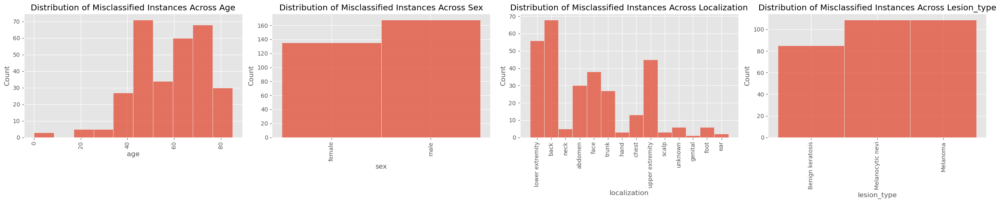

In [67]:
### Frequency of errors in different features

# Create a single row of 4 subplots, with a total figure size of 24x5 inches
fig, axs = plt.subplots(1, 4, figsize=(24, 5))

# Loop over the list of categories
for i, category in enumerate(['age', 'sex', 'localization', 'lesion_type']):
    
    # Select the subplot to plot on
    ax = axs[i]
    
    # Create a histogram of the current category, using the misclassified instances data
    sns.histplot(data=misclassified_instances, x=category, bins=10, ax=ax)
    
    # Set the title of the subplot
    ax.set_title(f'Distribution of Misclassified Instances Across {category.capitalize()}')
    
    # Rotate the x-axis labels by 90 degrees
    ax.tick_params(axis='x', rotation=90)

# Adjust the layout so that the subplots do not overlap
plt.tight_layout()

# Display the figure
plt.show()

In [68]:
# Function for visualizing all misclassified images
def visualize_all_misclassified_images(misclassified_instances):

    # List of unique labels
    classes = misclassified_instances['lesion_type'].unique()

    # Loop over the classes
    for class_label in classes:

        # Report
        print(f"All images for class ''{class_label}'' that were misclassified in test set:")

        # Filter the misclassified instances by class
        metadata_class = misclassified_instances[misclassified_instances['lesion_type'] == class_label]

        # Determine the number of rows needed
        rows = math.ceil(len(metadata_class) / 20)

        # Create a new figure
        plt.figure(figsize=(23, 1.2 * rows))

        # Loop over the misclassified instances of this class
        for i_index, i_row in enumerate(metadata_class.iterrows()):

            # Load the image
            img = keras.preprocessing.image.load_img(i_row[1]["image path"], target_size=(128, 128))
            img = keras.preprocessing.image.img_to_array(img)
            img = img / 255.0

            # Create a subplot for this image
            plt.subplot(rows, 20, i_index + 1)
            plt.imshow(img)
            plt.axis('off')

        plt.show()

All images for class ''Benign keratosis'' that were misclassified in test set:


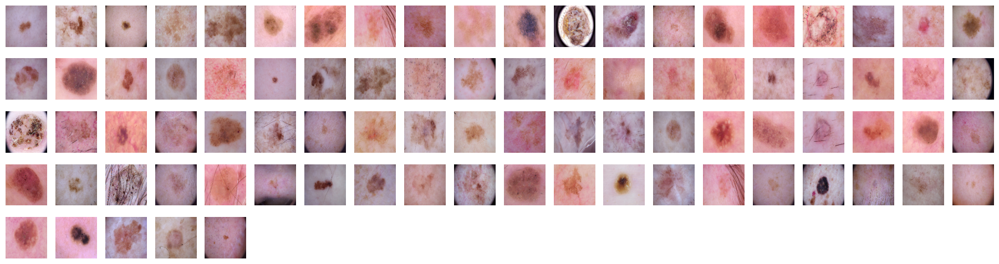

All images for class ''Melanocytic nevi'' that were misclassified in test set:


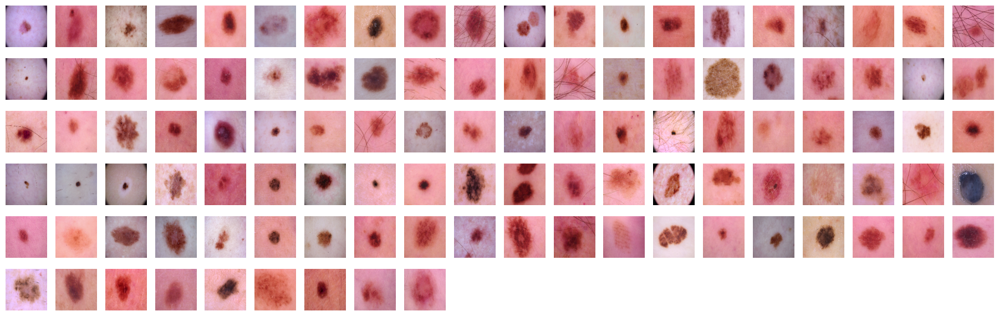

All images for class ''Melanoma'' that were misclassified in test set:


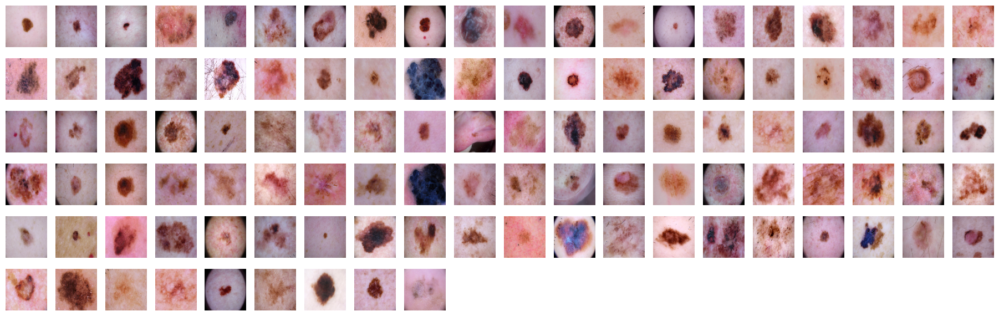

In [69]:
visualize_all_misclassified_images(misclassified_instances)

After reviewing the misclassified images for "Benign keratosis," "Melanocytic nevi," and "Melanoma," we can observe that the model's errors may be rooted in the following:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Error Category</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Benign Keratosis</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanocytic Nevi</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Melanoma</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Possible Causes</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Background Confusion</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Background features still mislead the model, resulting in errors.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Occlusions</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Occluded parts of lesions prevent correct classification.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Scale Variations</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Lesions of sizes not represented in the training data lead to misclassifications.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Lighting and Exposure Issues</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Poor lighting and exposure variation continue to be a challenge for the model.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Color Variations</td>
            <td style="border:1px solid black; padding:10px;"></td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">X</td>
            <td style="border:1px solid black; padding:10px;">Variability in color is not well-handled by the model, leading to errors.</td>
        </tr>
        <!-- ...Additional error categories would be listed here as needed -->
    </tbody>
</table>

Strategies for Improvement:

<table style="width:100%; border:1px solid black;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:left;">Improvement Strategy</th>
            <th style="border:1px solid black; padding:10px; text-align:left;">Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px;">Optimize Data Augmentation</td>
            <td style="border:1px solid black; padding:10px;">
            Include more data augmentation methods to expand the training dataset more.
            </td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Focused Data Collection</td>
            <td style="border:1px solid black; padding:10px;">
            Gather more data for the classes or features where the model shows weaknesses. For example, if certain types of lesions are frequently misclassified, try to collect more images of those types.
            </td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Model Architecture Optimization</td>
            <td style="border:1px solid black; padding:10px;">
            Experiment with different model architectures to find one that best captures the nuances in the data. This might include deeper networks or different activation functions.
            </td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Ensemble Methods</td>
            <td style="border:1px solid black; padding:10px;">
            Combine multiple models or use techniques like bagging and boosting to create an ensemble that may perform better than any individual model.
            </td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px;">Advanced Data Preprocessing</td>
            <td style="border:1px solid black; padding:10px;">
            Apply more sophisticated image preprocessing to highlight key features, such as edge detection filters or histogram equalization to improve contrast.
            </td>
        </tr>
    </tbody>
</table>

<br>

## Task 3.7 MLP From Scratch

---

In this section, we will implement a multi-layer perceptron (MLP) for image classification from scratch. It loads and preprocesses images from a metadata dataframe, converts them to grayscale, resizes them, and normalizes them. The images are then prepared for training by reshaping them into vectors and pairing them with labels. The MLP class defined in the script handles the neural network's initialization, forward and backward passes, training using gradient descent, and evaluation of performance. An MLP instance is created and trained on the dataset. The script outputs the training loss after each epoch to track progress. This setup provides a fundamental approach to neural network training for image classification tasks.

In [9]:
def load_and_preprocess_images(metadata_df, img_size=(64, 64)):
    """
    Load and preprocess images from the metadata dataframe.
    """

    # Get all the labels
    labels = metadata_df['label'].values

    # Initialize the list for images
    images = []

    # Loop over the image paths
    for img_path in tqdm(metadata_df['image path'], desc='Loading images', ncols=100, colour='green'):

        # Load the image
        img = Image.open(img_path).convert('L')  # Convert to grayscale
        img = img.resize(img_size)  # Resize image
        img_array = np.array(img)

        # Normalize the image data to [0, 1]
        img_array = img_array / 255.0

        # Add the image to the list
        images.append(img_array)

    return np.array(images), labels

In [10]:
# Call the function
images, labels = load_and_preprocess_images(metadata, img_size=(64, 64))

Loading images: 100%|███████████████████████████████████████████| 3297/3297 [00:42<00:00, 77.75it/s]


In [11]:
# Function to create training data tuples
def create_training_data(images, labels):
    """ Create training data in the format expected by SimpleMLP. """
    training_data = [(image.reshape(-1, 1), label) for image, label in zip(images, labels)]
    return training_data

In [12]:
# Call the function
training_data = create_training_data(images, labels)

In [16]:
# Class for multi layer perceptron (MLP) implementation from scratch
class MLP:


    # Constructor function
    def __init__(self, layer_sizes):

        # Initialize the weights and biases
        self.weights = [np.random.randn(y, x) * 0.1 for x, y in zip(layer_sizes[:-1], layer_sizes[1:])]
        self.biases = [np.random.randn(y, 1) * 0.1 for y in layer_sizes[1:]]

        # Initialize a list for saving all losses and accuracies
        self.losses = []
        self.accuracy = []


    # Forward pass function
    def forward(self, input_data):
        """ Perform a forward pass through the network. """

        # Initialize the activation
        activation = input_data

        # Loop over the weights and biases
        for b, w in zip(self.biases[:-1], self.weights[:-1]):

            # Compute the feedforward signal + activation
            activation = self.sigmoid(np.dot(w, activation) + b)

        # Return the final output
        return np.dot(self.weights[-1], activation) + self.biases[-1]


    # Train function
    def train(self, training_data, epochs, learning_rate):
        """ Train the MLP using a simple gradient descent algorithm. """

        # Loop over epochs
        for epoch in range(epochs):

            # Loope over the training instances
            for x, y in training_data:

                # Perform a backpropagation step
                nabla_b, nabla_w = self.backprop(x, y)

                # Update the weights and biases
                self.weights = [w - (learning_rate / len(training_data)) * nw 
                                for w, nw in zip(self.weights, nabla_w)]
                self.biases = [b - (learning_rate / len(training_data)) * nb 
                               for b, nb in zip(self.biases, nabla_b)]

            # Evaluate the network
            accuracy, loss = self.evaluate(training_data)

            # Save the loss and accuracy
            self.losses.append(np.mean(loss))
            self.accuracy.append(accuracy)

            # Report
            print(f"Epoch {epoch} complete - Loss: {np.mean(loss):.4f} - Accuracy: {accuracy:.4f}")

    # Function for performing a backward pass
    def backprop(self, x, y):
        """ Perform a backward pass through the network. """

        # Initialize the weights and biases to zero
        nabla_b = [np.zeros(b.shape) for b in self.biases]
        nabla_w = [np.zeros(w.shape) for w in self.weights]

        # Forward pass
        activation = x
        activations = [x]         # list to store all the activations
        zs = []                   # list to store all the z vectors

        # Loop over the weights and biases
        for b, w in zip(self.biases, self.weights):

            # Compute the feedforward pass
            z = np.dot(w, activation) + b

            # Store the z vector
            zs.append(z)

            # Compute the activation
            activation = self.sigmoid(z)

            # Store the activation
            activations.append(activation)

        ### Backward pass
            
        # Calculate the cost derivative
        delta = self.cost_derivative(activations[-1], y) * self.sigmoid_prime(zs[-1])

        # Assign the gradients for the output layer
        nabla_b[-1] = delta
        nabla_w[-1] = np.dot(delta, activations[-2].T)

        # Loop over the remaining layers
        for l in range(2, len(self.weights) + 1):

            # Get the last z vector
            z = zs[-l]

            # Compute the sigmoid prime
            sp = self.sigmoid_prime(z)

            # Compute the delta
            delta = np.dot(self.weights[-l + 1].T, delta) * sp

            # Assign the gradients
            nabla_b[-l] = delta
            nabla_w[-l] = np.dot(delta, activations[-l - 1].T)

        return nabla_b, nabla_w

    # Function for evaluating using loss and accuracy
    def evaluate(self, data):

        # Get the results and labels
        test_results = [self.forward(x) for (x, y) in data]
        test_labels = [np.argmax(y) for (x, y) in data]

        # Convert outputs to predicted class indices
        predicted_labels = [np.argmax(output) for output in test_results]

        # Calculate accuracy
        accuracy = sum(int(pred == label) for pred, label in zip(predicted_labels, test_labels)) / len(data)

        # Calculate loss 
        loss = [np.linalg.norm(self.forward(x) - y) for (x, y) in data]

        return accuracy, loss

    @staticmethod
    def sigmoid(z):
        """ The sigmoid function. """
        return 1.0 / (1.0 + np.exp(-z))

    @staticmethod
    def sigmoid_prime(z):
        """ Derivative of the sigmoid function. """
        return MLP.sigmoid(z) * (1 - MLP.sigmoid(z))

    @staticmethod
    def cost_derivative(output_activations, y):
        """ Return the vector of partial derivatives \partial C_x / \partial a for the output activations. """
        return (output_activations - y)


In [17]:
# Instantiate the MLP
mlp = MLP([images.shape[1] * images.shape[2], 512, 512, 3]) 

In [18]:
# Train the model
mlp.train(training_data, epochs=4, learning_rate=0.03)

Epoch 0 complete - Loss: 2.7705 - Accuracy: 0.0000
Epoch 1 complete - Loss: 2.1575 - Accuracy: 0.0003
Epoch 2 complete - Loss: 1.8784 - Accuracy: 0.0067
Epoch 3 complete - Loss: 1.8132 - Accuracy: 0.0212


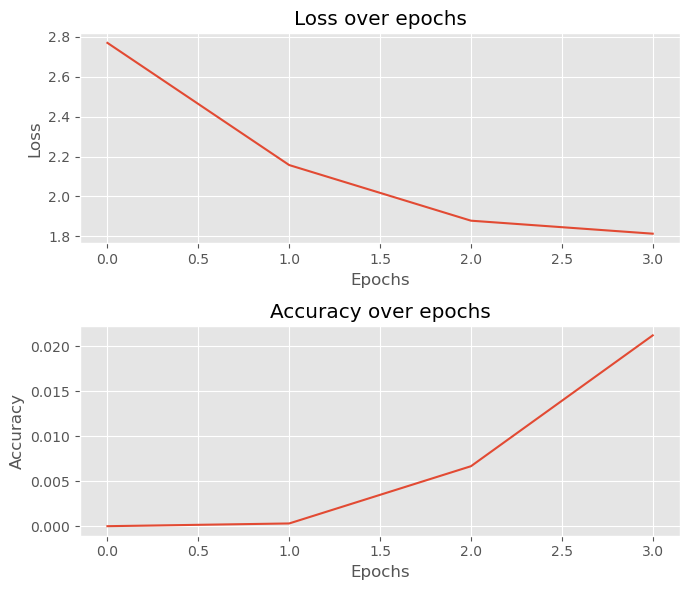

In [19]:
# Initialize a figure with two subplots, one for loss and one for accuracy
fig, (ax1, ax2) = plt.subplots(2, figsize=(7, 6))

# Plot the loss over epochs on the first subplot
ax1.plot(mlp.losses)
ax1.set_title('Loss over epochs')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')

# Plot the accuracy over epochs on the second subplot
ax2.plot(mlp.accuracy)
ax2.set_title('Accuracy over epochs')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')

# Display the plots
plt.tight_layout()
plt.show()

<br>

<h1 style="text-align:center;">  Section 4 - Human-Centered AI </h1>



<br>

## Task 4.1: Think-Aloud Study

---


##### Initial Prototype Version

Create an initial version of your prototype, either a wireframe prototype using Figma or by making a paper prototype

Link: <a href="https://www.figma.com/file/CPcWSRS9LBVZC0Fop2KHZz/Image-Classification-App-UI?type=design&node-id=301%3A2&mode=design&t=2m0y9LUZg1Pt2wAn-1">Initial wireframe design</a>

<br>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/1. initial wireframe.png" width=50%>
</div>

<br>

##### Gather Participants

Three participants have interacted with the prototype and conduct the think-aloud study.

1. Noah Ivanisevic
2. Erfan Salour
3. Nune Khachatryan

Here's the transcript for the think aloud study:

Participant 1:
- I see the app is simple to use. There are buttons to take or choose a photo. When I press "Take Image," I expect help on how to take a good photo, but there is none. I take a photo and get a result fast. 
- Suggestions: Add a way to talk to a real doctor to make sure the app's answer is right.
- Coding the data:
    - Knew what to do: Yes, for photo taking.
    - Confused: Yes, about photo-taking assistance.
    - Right action: Photo taken and result reviewed.
    - Wrong action: None observed.

Participant 2:
- The app is easy. I take a photo and see the result right away. But, I can't find how to see old results. I want to look at past photos and what the app said before.
- Suggestions: Put in a page to see old results to check changes over time.
- Coding the data:
    - Knew what to do: Yes, in general app usage.
    - Confused: Yes, about finding past results.
    - Right action: Photo taken and result viewed.
    - Wrong action: None, but difficulty finding archive could lead to confusion.

Participant 3:
- I start using the app. There is no place to sign in or out. This might not be safe for my private information. When I take a photo, there are no tips on how to do it right. The result is clear, but I think about things like sunlight that can hurt my skin.
- Suggestions: Add tips to the camera to help take the photo the right way. Make pages for signing in and out for better safety. Show the UV index for where I am to help me take care of my skin.
- Coding the data:
    - Knew what to do: Yes, for initial app interaction.
    - Confused: Yes, about sign-in/out and photo guidelines.
    - Right action: Successfully obtained results.
    - Wrong action: None, but potential for incorrect photo capture.

<br>

##### Analysis of Results


Here are the main key takeaways from the think-aloud study. Below you can see the list of suggested features for the application.

<table style="width:70%; border:1px solid black; text-align: left; margin-left: auto; margin-right: auto; ">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:center;">Priority</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Improvement Area</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Iteration Options</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Participant Number</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Revised</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">1</td>
            <td style="border:1px solid black; padding:10px;">Image Capture Assistance</td>
            <td style="border:1px solid black; padding:10px;">Implement guidelines overlay on camera for distance</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">3</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">✅</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">2</td>
            <td style="border:1px solid black; padding:10px;">Logging in/out pages</td>
            <td style="border:1px solid black; padding:10px;">Inlcude pages for loging in and loging out</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">3</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">✅</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">3</td>
            <td style="border:1px solid black; padding:10px;">Archive page</td>
            <td style="border:1px solid black; padding:10px;">Include an archive page for showing all the past predictions.</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">2</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">✅</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">4</td>
            <td style="border:1px solid black; padding:10px;">Chat with Human Doctor</td>
            <td style="border:1px solid black; padding:10px;">Add the option for contacting with human doctor for double checking the result</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">1</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">✅</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">5</td>
            <td style="border:1px solid black; padding:10px;">UV Index</td>
            <td style="border:1px solid black; padding:10px;">Add a feature so users can see the UV index based on their location. This can help them for skin health.</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">3</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">✅</td>
        </tr>
    </tbody>
</table>



<br>

##### Incorporate Changes


All the changes have been incorporate in the next iteration.

Link: <a href="https://www.figma.com/file/CPcWSRS9LBVZC0Fop2KHZz/Image-Classification-App-UI?type=design&node-id=153%3A756&mode=design&t=5y4npQh1McYLxGwl-1">wireframe design (second iteration)</a>

<br>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/2. wireframe (second iteration).png" width=90%>
</div>

<br>

## Task 4.2: A/B Testing

---


#### Introduction

- Version A (Control): The app interface without the image assistance feature. This is the current version of the app that users interact with, lacking overlays or guidance for taking pictures.

- Version B (Treatment): The app interface with the new image assistance feature integrated. This version includes on-screen guidelines and real-time feedback to aid users in capturing high-quality images suitable for analysis.

- Selection Process: The selection was made to directly compare the current standard user experience (Version A) with the proposed enhanced experience (Version B). This comparison aims to determine the impact of the image assistance feature on the user's ability to submit high-quality images.

- Reason for Testing These Versions:
The image assistance feature is a critical component for the app's core functionality, as the quality of the submitted images directly influences the accuracy of the skin cancer analysis. Testing these versions will provide insight into whether the added feature effectively supports users in this task.

- Hypothesis: Version B will increase the quality of submitted images, improve accuracy of analyses, and enhance user satisfaction.

<br>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/5. New feature in AB test.png" width=49%>
</div>


<br>

#### Wireframe Prototype using Figma

Two different version of the figma wireframe have been provided for the A/B test.

- Figma wireframe (Version A): <a src="https://www.figma.com/file/CPcWSRS9LBVZC0Fop2KHZz/Image-Classification-App-UI?type=design&node-id=153%3A756&mode=design&t=5y4npQh1McYLxGwl-1">LINK</a> 
- Figma wireframe (Version B): <a src="https://www.figma.com/file/CPcWSRS9LBVZC0Fop2KHZz/Image-Classification-App-UI?type=design&node-id=153%3A757&mode=design&t=5y4npQh1McYLxGwl-1">LINK</a> 

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/3. AB testing (version A).png" width=49%>
    <img src="./assets/4. AB testing (version B).png" width=49%>        
</div>



<br>


#### Questionnaire Forms 

Two forms have been provided for each version of the A/B test form.

- A/B Test Form (Version A): https://forms.office.com/e/nJBfjFgeek
- A/B Test Form (Version B): https://forms.office.com/e/9iHF9LwZBV

<br>

<div style="text-align: center; margin-left: auto; margin-right: auto; ">  
    <img src="./assets/form for AB testing.png" width=49%>
</div>

<br>

#### Test Plan

__Preparation:__

1. Wireframe Design: Ensure that the two Figma wireframes for versions A and B are as similar as possible, differing only in the specific elements you're testing. This will help isolate the impact of the changes.
2. Technical Check: Run a thorough check to ensure that the Microsoft questionnaires are functioning correctly on various devices.
3. Pilot Test: Consider conducting a small pilot test with a few participants to identify any unforeseen issues with the wireframes or questionnaires.

__A/B Test Plan:__

1. Introduction:
   - Provide a comprehensive explanation of the test's objective and the distinctions between versions A and B in the Microsoft Forms.
   - Create participant lists for each version, A and B. This task will be done by mentors.

2. Task Execution:
   - Develop a detailed schedule for students to participate in the test. This task will be done by mentors.

3. Survey Completion:
   - Supervise the process to ensure accurate and complete survey submissions by participants. This task will be done by mentors.

4. Survey Distribution
   - Mentors distribute the survey through Microsoft Teams to all participants.

__Post-Test:__

1. Data Analysis: Apply statistical techniques suited for A/B testing to evaluate the response differences between versions A and B.
2. Reporting: Generate reports providing insights into user preferences and behaviors.

In [31]:
# Load the test result for A/B testing
test_result_version_a = pd.read_excel("./AB test result/A/A_B Test (Version A).xlsx")
test_result_version_b = pd.read_excel("./AB test result/B/A_B Test (Version B).xlsx")

# Report
print(f"{len(test_result_version_a)} people participated in version A of the A/B test.")    
print(f"{len(test_result_version_b)} people participated in version B of the A/B test.")

20 people participated in version A of the A/B test.
20 people participated in version B of the A/B test.




<br>


#### Analyze the Result Using T-Test

Analyse the results of the A/B test using a t-test




In [32]:
# Load the test results
df_A = pd.read_excel("./AB test result/A/A_B Test (Version A).xlsx")
df_B = pd.read_excel("./AB test result/B/A_B Test (Version B).xlsx")

# Drop any zero or NaN columns
df_A = df_A.dropna(axis=1, how='all').loc[:, (df_A != 0).any(axis=0)]
df_B = df_B.dropna(axis=1, how='all').loc[:, (df_B != 0).any(axis=0)]

In [33]:
# Convert qualitative to quantitative

# Dictionary for convering qualitative to quantitative
qual_to_quant = {"Completely Disagree": 1, "Disagree": 2, "Neutral": 3, "Agree": 4, "Completely Agree": 5}

# Columns that start with Questionnaire
questionnaire_cols = [col for col in df_A.columns if col.startswith('Questionnaire')]

# Convert qualitative to quantitative (Version A)
df_A[questionnaire_cols] = df_A[questionnaire_cols].applymap(qual_to_quant.get)

# Convert qualitative to quantitative (Version B)
df_B[questionnaire_cols] = df_B[questionnaire_cols].applymap(qual_to_quant.get)

df_A.head()

,Id,Start time,Completion time,Email,Questionnaire.I understood what I could use the app for.,Questionnaire.I found the application intuitive to use,Questionnaire.I thought the application was useful,Questionnaire.I enjoyed using the application.,"Questionnaire.I believe the way I captured the image (e.g., distance, angle) will lead to an accurate analysis by the app."
0,1,2024-04-09 10:22:04,2024-04-09 10:26:17,anonymous,4,4,4,4,3
1,2,2024-04-09 10:26:17,2024-04-09 10:28:33,anonymous,5,5,5,5,3
2,3,2024-04-09 10:30:31,2024-04-09 10:32:42,anonymous,4,4,4,3,4
3,4,2024-04-09 10:32:16,2024-04-09 10:34:31,anonymous,5,4,5,4,2
4,5,2024-04-09 10:32:24,2024-04-09 10:34:34,anonymous,5,5,5,5,5


In [34]:
# Change columns names
question_shortener = {
    "Questionnaire.I understood what I could use the app for.": "Q1",
    "Questionnaire.I found the application intuitive to use": "Q2",
    "Questionnaire.I thought the application was useful": "Q3",
    "Questionnaire.I enjoyed using the application.": "Q4",
    "Questionnaire.I believe the way I captured the image (e.g., distance, angle) will lead to an accurate analysis by the app.": "Q5"
}

# Shorten the column names
df_A = df_A.rename(columns=question_shortener)
df_B = df_B.rename(columns=question_shortener)

df_A.head()

,Id,Start time,Completion time,Email,Q1,Q2,Q3,Q4,Q5
0,1,2024-04-09 10:22:04,2024-04-09 10:26:17,anonymous,4,4,4,4,3
1,2,2024-04-09 10:26:17,2024-04-09 10:28:33,anonymous,5,5,5,5,3
2,3,2024-04-09 10:30:31,2024-04-09 10:32:42,anonymous,4,4,4,3,4
3,4,2024-04-09 10:32:16,2024-04-09 10:34:31,anonymous,5,4,5,4,2
4,5,2024-04-09 10:32:24,2024-04-09 10:34:34,anonymous,5,5,5,5,5


In [38]:
# Initialize an empty DataFrame to store the results
results_df = pd.DataFrame()

# Iterate over a list of question identifiers
for question_id in ["Q1", "Q2", "Q3", "Q4", "Q5"]:

    # Run the shaprio-wilk statistical test for each question to check whether the data is normally distributed
    normality_a = stats.shapiro(df_A[question_id])
    normality_b = stats.shapiro(df_B[question_id])

    # Run Levene's test for checking if the variance of both samples is equal
    homogeneity = stats.levene(df_A[question_id], df_B[question_id])

    # If data is normally distributed AND variances are equal
    if (normality_a.pvalue > 0.05) and (normality_b.pvalue > 0.05) and (homogeneity.pvalue > 0.05):

        # Run Independent Samples T-test 
        out = stats.ttest_ind(df_A[question_id], df_B[question_id])

    # If data is not normally distributed OR variances are not equal
    else:

        # Run Bootstrapped Independent Samples T-test
        rng = np.random.default_rng()                 # create random sampling
        out = stats.ttest_ind(df_A[question_id], df_B[question_id], random_state = rng)

    # Gather all info inside a dictionary
    info_df = pd.DataFrame({
        "Question ID": [question_id],
        "Test Statistic": [out.statistic],
        "P-value (t-test)": [out.pvalue],
        "Normality A": [normality_a.pvalue],
        "Normality B": [normality_b.pvalue],
        "Homogeneity": [homogeneity.pvalue],
    })

    # Append the results to the DataFrame
    results_df = pd.concat([results_df, info_df], ignore_index=True)

# Display the final results DataFrame
results_df


,Question ID,Test Statistic,P-value (t-test),Normality A,Normality B,Homogeneity
0,Q1,-1.378405,0.176140,0.000006,2.888758e-07,0.176140
1,Q2,-0.308994,0.759014,0.000007,8.099750e-06,0.663804
2,Q3,0.632456,0.530877,0.000004,7.386869e-06,0.530877
3,Q4,0.565355,0.575155,0.000249,2.773008e-04,0.713646
4,Q5,-1.294191,0.203410,0.013083,8.067772e-04,0.019262




<br>


#### Result Interpretation of the A/B Test (using a T-Test)

This analysis focuses on comparing user responses from two versions of an app in five key areas: Understanding of the App, Intuitiveness, Usefulness, Enjoyment, and Feedback on the Image Assistance Feature.

<table style="width:95%; border:1px solid black; text-align: left; margin-left: auto; margin-right: auto;">
    <thead>
        <tr style="background-color:#aa69fa;">
            <th style="border:1px solid black; padding:10px; text-align:center;">Question ID</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Aspect Evaluated</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">T-Test P-value</th>
            <th style="border:1px solid black; padding:10px; text-align:center;">Interpretation</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">Q1</td>
            <td style="border:1px solid black; padding:10px;">Understanding of the App</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">0.176140</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">No significant difference, suggesting similar levels of understanding between the versions.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">Q2</td>
            <td style="border:1px solid black; padding:10px;">Intuitiveness of the App</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">0.759014</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">No significant difference, indicating comparable intuitiveness in both versions.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">Q3</td>
            <td style="border:1px solid black; padding:10px;">Usefulness of the App</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">0.530877</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">No significant difference, implying users found both versions equally useful.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">Q4</td>
            <td style="border:1px solid black; padding:10px;">Enjoyment of the App</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">0.575155</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">No significant difference, suggesting similar levels of enjoyment for both versions.</td>
        </tr>
        <tr>
            <td style="border:1px solid black; padding:10px; text-align:center;">Q5</td>
            <td style="border:1px solid black; padding:10px;">Feedback on Image Assistance</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">0.203410</td>
            <td style="border:1px solid black; padding:10px; text-align:center;">No significant difference, indicating user feedback on the image assistance feature is similar for both versions.</td>
        </tr>
    </tbody>
</table>

<br>

__Conclusion:__

- The analysis reveals that there are no statistically significant differences between the two versions of the app across all the evaluated aspects.
- This implies that, based on the survey data, neither version (A or B) can be conclusively considered superior in terms of user experience.

<br>

## Task 4.3:  Create a Final Wireframe and Demo Video

---

Add a link to your final wireframe and a link to your demo video here!

Links:
- Demo video (without explaination): <a href="https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-SoheilMohammadpour231754/blob/main/Deliverables/skin%20cancer%20classification/demo%20videos/demo%20(without%20explaination).mp4">LINK</a>
- Demo video (with explaination): <a href="https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-SoheilMohammadpour231754/blob/main/Deliverables/skin%20cancer%20classification/demo%20videos/demo%20(with%20explaination).mp4">LINK</a>

<br>

<div style="display: flex;">
  <div style="flex: 50%;">
    <h4>Demo Video (Without Explaination)</h4>
    <video style="width: 95%;" controls>
        <source src="./demo videos/demo (without explaination).mp4" type="video/mp4">
        Your browser does not support the video tag.
    </video>
  </div>
  <div style="flex: 50%;">
    <h4>Demo Video (With Explaination)</h4>
    <video style="width: 95%;" controls>
        <source src="./demo videos/demo (with explaination).mp4" type="video/mp4">
        Your browser does not support the video tag.
    </video>
  </div>
</div>


<br>

<h1 style="text-align:center;">  Section 5 - Final Project Presentation </h1>



<br>

## Task 5: Presentation Slides

---

Add a link to your presentation slides here!

- Presentation slides: <a href="https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-SoheilMohammadpour231754/blob/main/Deliverables/skin%20cancer%20classification/Project-Presentation.pptx">LINK</a>

<br>

### THE END